<a href="https://colab.research.google.com/github/DanialBahrami/power_demand_prediction/blob/main/power_demand_draft.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

**Electricity Demand Prediction for the next day (next 24 hours).**

*Objective:*

>  We need to predict the demand for the next 24 hours by utilizing past electricity demand data points, humidity, temperature, dew point, and other drivers like weekdays, holidays, and etc. The accuracy of this model is so critical (Accuracy > 0.95 for a sample day is acceptable, or AE < 700 in july or august months)

Inputs: 

- Excel file containing all drivers


Data Considerations: 

- The data set may contain outliers and abnormal values.

Output: 

- A 24-hour demand forecast for a sample day

Success Criteria: 

- The acceptable error rate must be less than 5% (MAE < 500 MW, or accuracy more than 95%)

Deliverables: 

- A clean and understandable Jupyter file with well-documented code
- An explanation of the work process in a meeting (no file submission required)

Deadline: 

- five days after the task description has been sent

Evaluation:

- The work will be evaluated based on the accuracy of the electricity demand forecast, the clarity of the code and documentation, and the overall effectiveness of the solution.




In [1]:
import os
import datetime

import IPython
import IPython.display
import matplotlib as mpl
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import seaborn as sns
import tensorflow as tf

mpl.rcParams['figure.figsize'] = (8, 6)
mpl.rcParams['axes.grid'] = False

In [2]:
# google drive conncection
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [3]:
# read data 
df = pd.read_csv('/content/drive/MyDrive/Colab Notebooks/CamrosTech/Dataset.csv',
					index_col ='Date',
					parse_dates = True)

# Print the first five rows of the dataset
df.head()
df_orginal = df.copy()
df_orginal

,Weekday,Hour,HOEP,Power_Demand,Temperature,Windchill_Index,Wind_Speed,Humidex,Relative_Humidity,Dew_Point,Pressure_Station
Date,,,,,,,,,,,
2016-01-01,Friday,0,0.49,14023,-0.3,-5.62,20,-3.18,70,-5.1,99.67
2016-01-01,Friday,1,-1.09,13417,-0.3,-6.30,25,-3.48,68,-5.5,99.63
2016-01-01,Friday,2,-2.41,12968,-0.4,-6.55,26,-3.43,73,-4.7,99.59
2016-01-01,Friday,12,0.00,14215,-2.1,-8.72,23,-4.86,76,-5.8,99.39
2016-01-01,Friday,13,0.00,14443,-2.4,-8.23,19,-5.09,84,-4.7,99.35
...,...,...,...,...,...,...,...,...,...,...,...
2020-12-31,Thursday,19,36.85,17384,0.2,-4.02,13,-2.69,74,-3.8,100.66
2020-12-31,Thursday,20,19.69,16783,-0.2,-5.59,16,-3.58,65,-6.0,100.76
2020-12-31,Thursday,21,20.78,16154,-3.0,-7.44,12,-3.67,80,-6.0,100.81


**EDA and Data Profiling**

In [4]:
df.reset_index(inplace=True)
df

,Date,Weekday,Hour,HOEP,Power_Demand,Temperature,Windchill_Index,Wind_Speed,Humidex,Relative_Humidity,Dew_Point,Pressure_Station
0,2016-01-01,Friday,0,0.49,14023,-0.3,-5.62,20,-3.18,70,-5.1,99.67
1,2016-01-01,Friday,1,-1.09,13417,-0.3,-6.30,25,-3.48,68,-5.5,99.63
2,2016-01-01,Friday,2,-2.41,12968,-0.4,-6.55,26,-3.43,73,-4.7,99.59
3,2016-01-01,Friday,12,0.00,14215,-2.1,-8.72,23,-4.86,76,-5.8,99.39
4,2016-01-01,Friday,13,0.00,14443,-2.4,-8.23,19,-5.09,84,-4.7,99.35
...,...,...,...,...,...,...,...,...,...,...,...,...
39403,2020-12-31,Thursday,19,36.85,17384,0.2,-4.02,13,-2.69,74,-3.8,100.66
39404,2020-12-31,Thursday,20,19.69,16783,-0.2,-5.59,16,-3.58,65,-6.0,100.76
39405,2020-12-31,Thursday,21,20.78,16154,-3.0,-7.44,12,-3.67,80,-6.0,100.81
39406,2020-12-31,Thursday,22,27.85,15744,-0.8,-6.76,17,-4.11,70,-5.6,100.90


I've used ydata (pandas profiling) for feature analysis. link to the library: https://github.com/ydataai/ydata-profiling

In [5]:
# using ydata (panda profiling) for feature analysis
!pip install ydata-profiling
IPython.display.clear_output()

In [6]:
from ydata_profiling import ProfileReport
profile = ProfileReport(df, tsmode=True, sortby="Date", title="Profiling Report")
profile

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

**Remove Multicollinearity**

When two or more variables are highly correlated, they carry almost the same information, making it redundant to include all of them in a model. This can lead to a problem known as multicollinearity 

In [7]:
corr = df.corr()

<ipython-input-7-45893e33df67>:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  corr = df.corr()


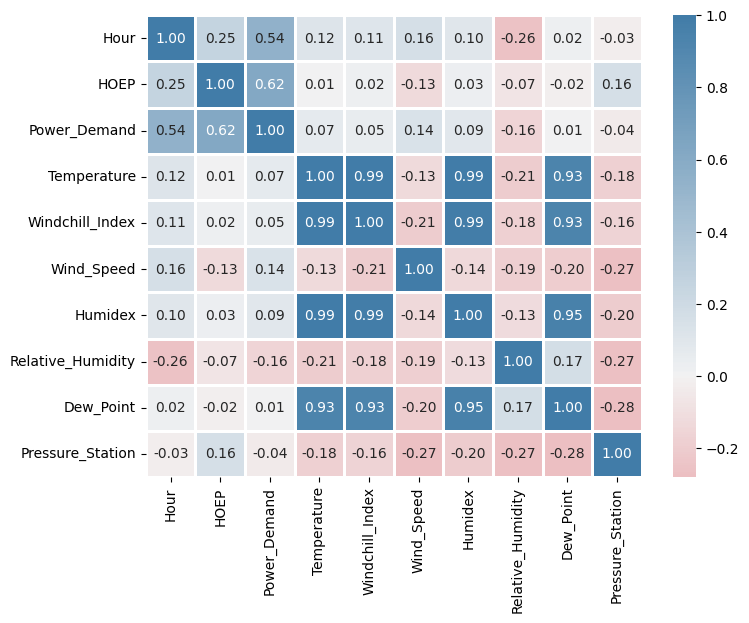

In [10]:
cmap = sns.diverging_palette(h_neg=10, h_pos=240, as_cmap=True)
sns.heatmap(corr, cmap=cmap, center=0, linewidths=1, annot=True, fmt=".2f")
plt.show()

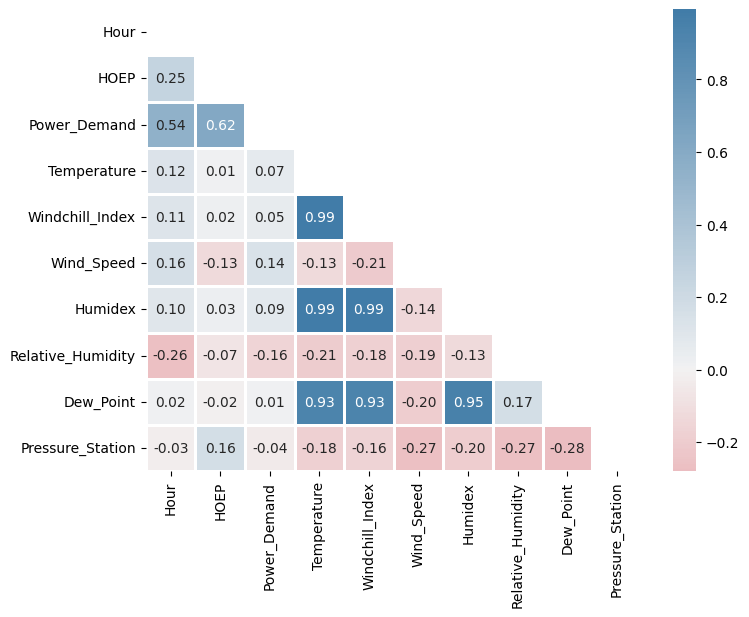

In [14]:
mask = np.triu(np.ones_like(corr, dtype=bool))
sns.heatmap(corr, cmap=cmap, mask=mask, center=0, linewidths=1, annot=True, fmt=".2f")
plt.show()

In [15]:
#create positive correlation matrix
corr_pos = corr.abs()
corr_pos_tri= corr_pos.mask(mask)
corr_pos_tri

,Hour,HOEP,Power_Demand,Temperature,Windchill_Index,Wind_Speed,Humidex,Relative_Humidity,Dew_Point,Pressure_Station
Hour,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
HOEP,0.251456,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Power_Demand,0.543581,0.615273,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Temperature,0.119294,0.009442,0.066501,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Windchill_Index,0.109306,0.020256,0.053868,0.993878,NaN,NaN,NaN,NaN,NaN,NaN
Wind_Speed,0.160503,0.128610,0.138297,0.127319,0.207184,NaN,NaN,NaN,NaN,NaN
Humidex,0.101408,0.030895,0.087921,0.991548,0.987675,0.137766,NaN,NaN,NaN,NaN
Relative_Humidity,0.263691,0.070164,0.159712,0.205372,0.179861,0.189601,0.125058,NaN,NaN,NaN
Dew_Point,0.018391,0.015680,0.008641,0.926284,0.929150,0.198264,0.950906,0.171680,NaN,NaN
Pressure_Station,0.026880,0.164161,0.038740,0.184491,0.163875,0.265545,0.200440,0.269235,0.280142,NaN


In [49]:
drop_cand = [c for c in corr_pos_tri.columns if any(corr_pos_tri[c] >= 0.95) or any(corr_pos_tri.loc[c] >= 0.95)]
drop_cand

['Temperature', 'Windchill_Index', 'Humidex', 'Dew_Point']

In [50]:
corr_pos_tri.loc[drop_cand, 'Power_Demand'].sort_values(ascending=False)

Humidex            0.087921
Temperature        0.066501
Windchill_Index    0.053868
Dew_Point          0.008641
Name: Power_Demand, dtype: float64

In [51]:
to_drop = ['Temperature', 'Windchill_Index', 'Dew_Point']
df_reduced = df.drop(to_drop, axis=1)
df_reduced

,Date,Weekday,Hour,HOEP,Power_Demand,Wind_Speed,Humidex,Relative_Humidity,Pressure_Station
0,2016-01-01,Friday,0,0.49,14023,20,-3.18,70,99.67
1,2016-01-01,Friday,1,-1.09,13417,25,-3.48,68,99.63
2,2016-01-01,Friday,2,-2.41,12968,26,-3.43,73,99.59
3,2016-01-01,Friday,12,0.00,14215,23,-4.86,76,99.39
4,2016-01-01,Friday,13,0.00,14443,19,-5.09,84,99.35
...,...,...,...,...,...,...,...,...,...
39403,2020-12-31,Thursday,19,36.85,17384,13,-2.69,74,100.66
39404,2020-12-31,Thursday,20,19.69,16783,16,-3.58,65,100.76
39405,2020-12-31,Thursday,21,20.78,16154,12,-3.67,80,100.81
39406,2020-12-31,Thursday,22,27.85,15744,17,-4.11,70,100.90


<ipython-input-52-44ee6ed46b1a>:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  corr_r = df_reduced.corr()


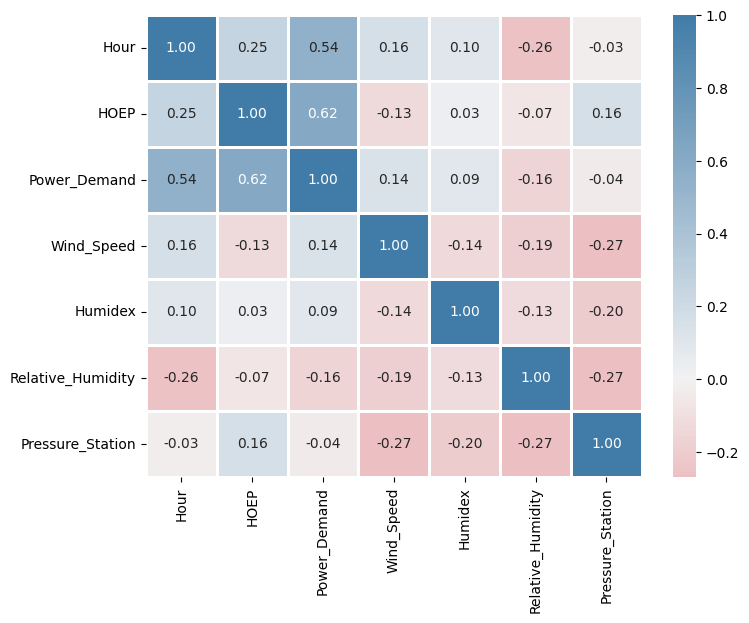

In [52]:
corr_r = df_reduced.corr()
cmap = sns.diverging_palette(h_neg=10, h_pos=240, as_cmap=True)
sns.heatmap(corr_r, cmap=cmap, center=0, linewidths=1, annot=True, fmt=".2f")
plt.show()

**Removing Outliers**

To simplify the process, I utilized Pycaret, a framework known for its user-friendly interface and ease of use. https://github.com/pycaret/pycaret

In [60]:
# using Pycaret library for regression 
!pip install --upgrade pycaret
IPython.display.clear_output()

In [68]:
df_reduced

,Date,Weekday,Hour,HOEP,Power_Demand,Wind_Speed,Humidex,Relative_Humidity,Pressure_Station
0,2016-01-01,Friday,0,0.49,14023,20,-3.18,70,99.67
1,2016-01-01,Friday,1,-1.09,13417,25,-3.48,68,99.63
2,2016-01-01,Friday,2,-2.41,12968,26,-3.43,73,99.59
3,2016-01-01,Friday,12,0.00,14215,23,-4.86,76,99.39
4,2016-01-01,Friday,13,0.00,14443,19,-5.09,84,99.35
...,...,...,...,...,...,...,...,...,...
39403,2020-12-31,Thursday,19,36.85,17384,13,-2.69,74,100.66
39404,2020-12-31,Thursday,20,19.69,16783,16,-3.58,65,100.76
39405,2020-12-31,Thursday,21,20.78,16154,12,-3.67,80,100.81
39406,2020-12-31,Thursday,22,27.85,15744,17,-4.11,70,100.90


In [80]:
days = {'Monday':0, 'Tuesday':1, 'Wednesday':2, 'Thursday':3, 'Friday':4, 'Saturday':5, 'Sunday':6}
df_reduced['Weekday'] = df_reduced['Weekday'].map(days)
df_reduced

,Date,Weekday,Hour,HOEP,Power_Demand,Wind_Speed,Humidex,Relative_Humidity,Pressure_Station
0,2016-01-01,4,0,0.49,14023,20,-3.18,70,99.67
1,2016-01-01,4,1,-1.09,13417,25,-3.48,68,99.63
2,2016-01-01,4,2,-2.41,12968,26,-3.43,73,99.59
3,2016-01-01,4,12,0.00,14215,23,-4.86,76,99.39
4,2016-01-01,4,13,0.00,14443,19,-5.09,84,99.35
...,...,...,...,...,...,...,...,...,...
39403,2020-12-31,3,19,36.85,17384,13,-2.69,74,100.66
39404,2020-12-31,3,20,19.69,16783,16,-3.58,65,100.76
39405,2020-12-31,3,21,20.78,16154,12,-3.67,80,100.81
39406,2020-12-31,3,22,27.85,15744,17,-4.11,70,100.90


In [84]:
df_ol = df_reduced.drop(columns=['Date'])

**t-SNE Visualization to better check outliers**

In [87]:
#t-SNE visualization 
from sklearn.manifold import TSNE
m = TSNE()

In [88]:
tsne_features = m.fit_transform(df_ol)

In [90]:
tsne_features.shape

(39408, 2)

In [91]:
df_ol['X'] = tsne_features[:, 0]
df_ol['Y'] = tsne_features[:, 1]

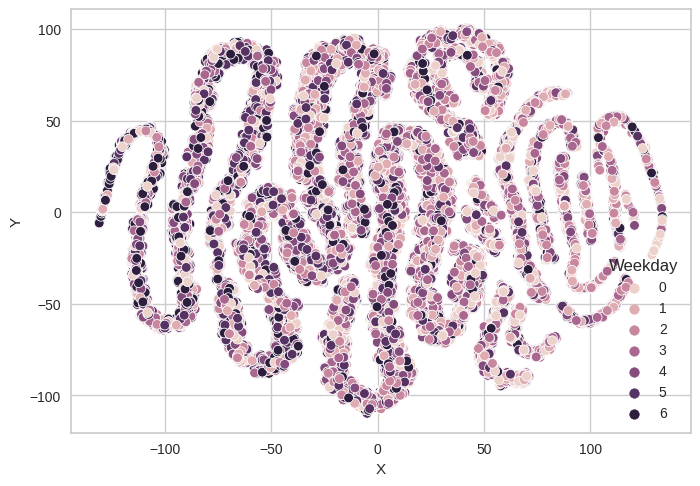

In [94]:
sns.scatterplot(data=df_ol, x="X", y="Y", hue="Weekday")
plt.show()

/usr/local/lib/python3.10/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


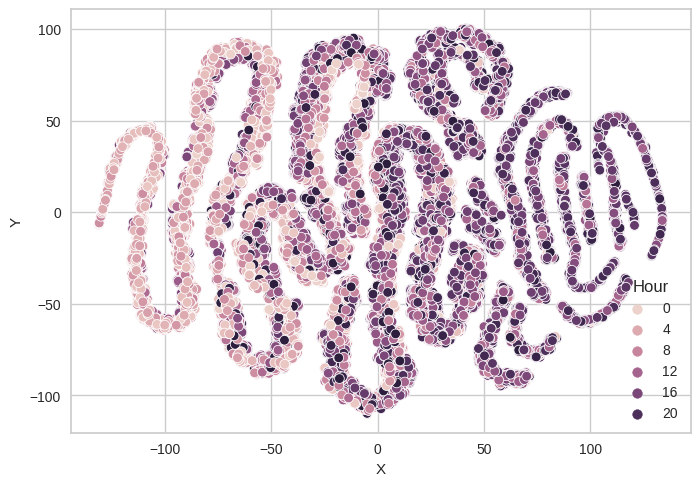

In [95]:
sns.scatterplot(data=df_ol, x="X", y="Y", hue="Hour")
plt.show()

**Isolated Forest for Anomaly Detection**

In [96]:
from pycaret.anomaly import *
s = setup(df_ol.drop(columns=['X', 'Y']), 
          session_id = 123,)

,Description,Value
0,Session id,123
1,Original data shape,"(39408, 8)"
2,Transformed data shape,"(39408, 8)"
3,Numeric features,8
4,Preprocess,True
5,Imputation type,simple
6,Numeric imputation,mean
7,Categorical imputation,mode
8,CPU Jobs,-1
9,Use GPU,False


In [97]:
iforest = create_model('iforest')

Processing:   0%|          | 0/3 [00:00<?, ?it/s]

In [98]:
iforest_results = assign_model(iforest)
iforest_results.head()

,Weekday,Hour,HOEP,Power_Demand,Wind_Speed,Humidex,Relative_Humidity,Pressure_Station,Anomaly,Anomaly_Score
0,4,0,0.49,14023,20,-3.18,70,99.669998,0,-0.083681
1,4,1,-1.09,13417,25,-3.48,68,99.629997,0,-0.085557
2,4,2,-2.41,12968,26,-3.43,73,99.589996,0,-0.085546
3,4,12,0.00,14215,23,-4.86,76,99.389999,0,-0.108381
4,4,13,0.00,14443,19,-5.09,84,99.349998,0,-0.105044


In [99]:
iforest_results['Anomaly'].sum()

1971

In [ ]:
!pip install umap-learn

In [ ]:
!pip install pycaret[analysis]

In [ ]:
# import umap
# plot_model(iforest, plot = 'umap')

In [100]:
df_ol['Anomaly'] = iforest_results['Anomaly']

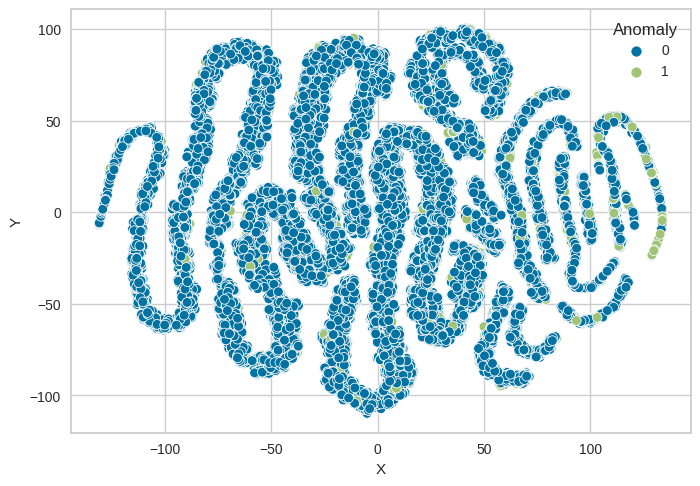

In [101]:
sns.scatterplot(data=df_ol, x="X", y="Y", hue="Anomaly")
plt.show()

In [102]:
df_ol.columns

Index(['Weekday', 'Hour', 'HOEP', 'Power_Demand', 'Wind_Speed', 'Humidex',
       'Relative_Humidity', 'Pressure_Station', 'X', 'Y', 'Anomaly'],
      dtype='object')

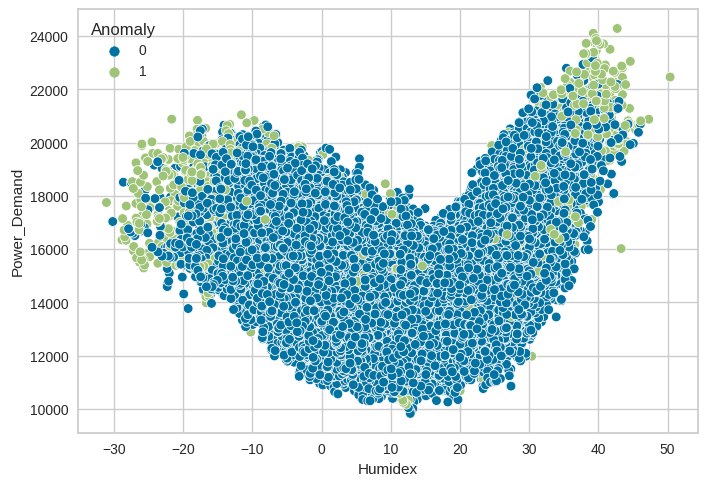

In [104]:
sns.scatterplot(data=df_ol, x="Humidex", y="Power_Demand", hue="Anomaly")
plt.show()

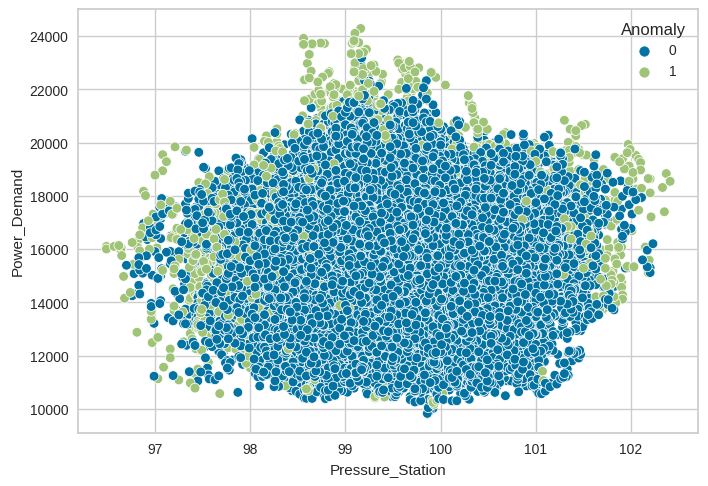

In [105]:
sns.scatterplot(data=df_ol, x="Pressure_Station", y="Power_Demand", hue="Anomaly")
plt.show()

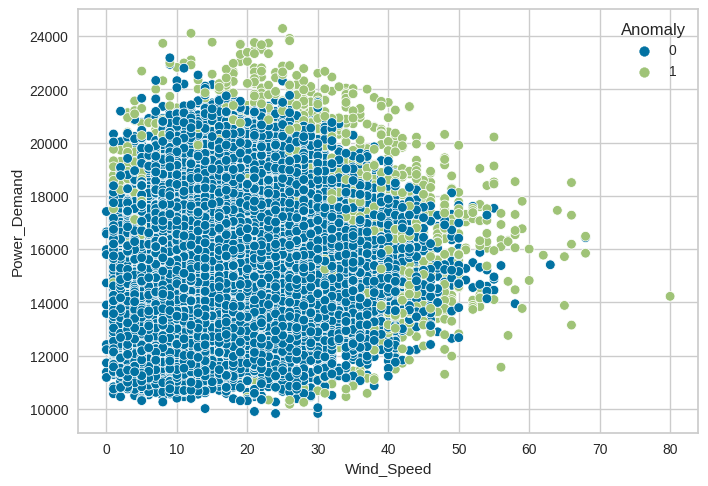

In [106]:
sns.scatterplot(data=df_ol, x="Wind_Speed", y="Power_Demand", hue="Anomaly")
plt.show()

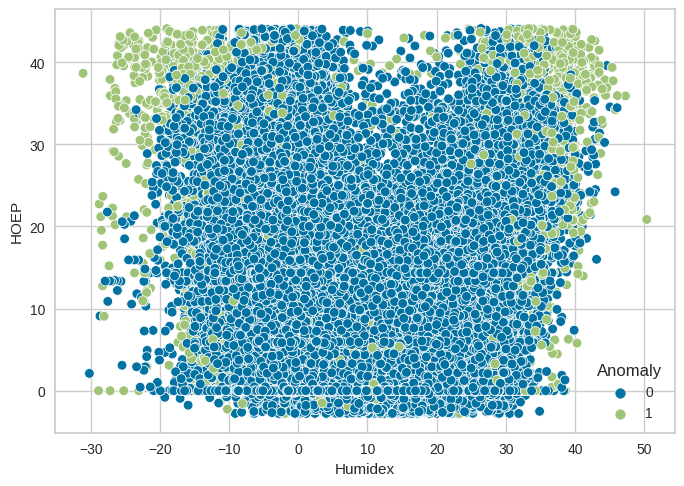

In [108]:
sns.scatterplot(data=df_ol, x="Humidex", y="HOEP", hue="Anomaly")
plt.show()

**Z-Score for outlier detection - column wise**

In [118]:
df_zs= df_ol.drop(columns=['X', 'Y', 'Anomaly'])
df_zs

,Weekday,Hour,HOEP,Power_Demand,Wind_Speed,Humidex,Relative_Humidity,Pressure_Station
0,4,0,0.49,14023,20,-3.18,70,99.67
1,4,1,-1.09,13417,25,-3.48,68,99.63
2,4,2,-2.41,12968,26,-3.43,73,99.59
3,4,12,0.00,14215,23,-4.86,76,99.39
4,4,13,0.00,14443,19,-5.09,84,99.35
...,...,...,...,...,...,...,...,...
39403,3,19,36.85,17384,13,-2.69,74,100.66
39404,3,20,19.69,16783,16,-3.58,65,100.76
39405,3,21,20.78,16154,12,-3.67,80,100.81
39406,3,22,27.85,15744,17,-4.11,70,100.90


In [124]:
# normalize data
mean = df_zs.mean()
std = df_zs.std()
df_scaled = (df_zs - mean) / std
df_scaled.head()

,Weekday,Hour,HOEP,Power_Demand,Wind_Speed,Humidex,Relative_Humidity,Pressure_Station
0,0.514428,-1.673844,-1.128627,-0.624609,0.341184,-0.910216,0.117529,0.175609
1,0.514428,-1.529859,-1.261373,-0.899908,0.883476,-0.931157,-0.001705,0.124109
2,0.514428,-1.385873,-1.372275,-1.103883,0.991934,-0.927667,0.296379,0.072609
3,0.514428,0.053984,-1.169795,-0.537385,0.666559,-1.027488,0.475230,-0.184892
4,0.514428,0.197969,-1.169795,-0.433807,0.232725,-1.043543,0.952164,-0.236392


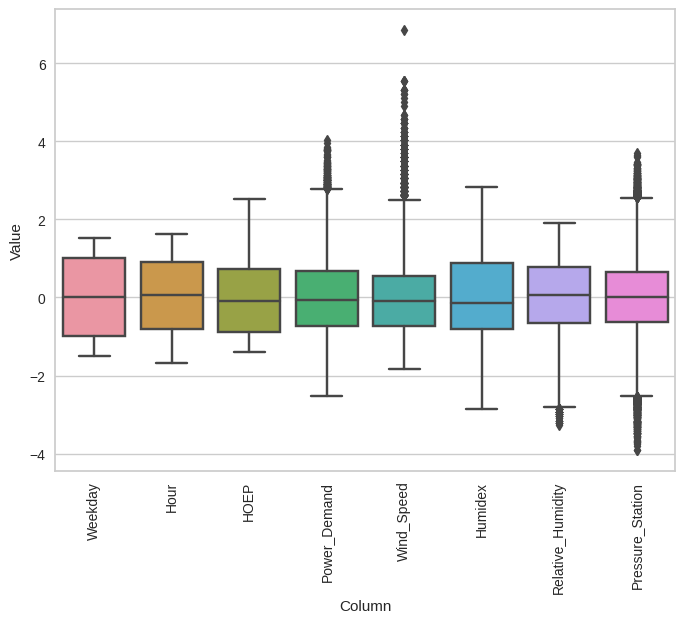

In [128]:
df_melt = df_scaled.melt(var_name='Column', value_name='Value')
plt.figure(figsize=(8, 6))
ax = sns.boxplot(x='Column', y='Value', data=df_melt)
_ = ax.set_xticklabels(df_zs.keys(), rotation=90)

In [152]:
def zscore(df, column):

  # IQR
  # Calculate the upper and lower limits
  Q1 = df[column].quantile(0.25)
  Q3 = df[column].quantile(0.75)
  IQR = Q3 - Q1
  lower = Q1 - 1.5*IQR
  upper = Q3 + 1.5*IQR

  indexes = df.loc[(df[column]<lower) | (df_zs[column]> upper)].index

  return lower, upper, indexes

In [153]:
for c in df_zs.columns:
  lower_bond, upper_bond, outliers_index = zscore(df_zs, c)
  print("# outliers in column " + str(c) + " -> " + str(len(outliers_index)) + 
        " Lower Limit is " + str(lower_bond) + " Upper Limit is " + str(upper_bond))
  df_zs.drop(outliers_index, inplace=True)

# outliers in column Weekday -> 0Lower Limit is -5.0Upper Limit is 11.0
# outliers in column Hour -> 0Lower Limit is -12.0Upper Limit is 36.0
# outliers in column HOEP -> 0Lower Limit is -25.515Upper Limit is 51.325
# outliers in column Power_Demand -> 154Lower Limit is 9116.0Upper Limit is 21540.0
# outliers in column Wind_Speed -> 718Lower Limit is -8.0Upper Limit is 40.0
# outliers in column Humidex -> 0Lower Limit is -37.519999999999996Upper Limit is 58.239999999999995
# outliers in column Relative_Humidity -> 58Lower Limit is 21.0Upper Limit is 117.0
# outliers in column Pressure_Station -> 618Lower Limit is 97.6Upper Limit is 101.52000000000001


In [154]:
df_zs.shape
#39408 - 37860 = 1548

(37860, 8)

In [155]:
mean_rm_ol = df_zs.mean()
std_rm_ol = df_zs.std()
df_scaled_rm_ol = (df_zs - mean_rm_ol) / std_rm_ol
df_scaled_rm_ol.head()

,Weekday,Hour,HOEP,Power_Demand,Wind_Speed,Humidex,Relative_Humidity,Pressure_Station
0,0.513948,-1.659001,-1.136386,-0.614735,0.446804,-0.932715,0.110512,0.160837
1,0.513948,-1.515644,-1.269532,-0.893822,1.044398,-0.953818,-0.009705,0.105477
2,0.513948,-1.372287,-1.380768,-1.100604,1.163917,-0.950301,0.290837,0.050117
3,0.513948,0.061281,-1.177678,-0.526311,0.805360,-1.050893,0.471163,-0.226683
4,0.513948,0.204637,-1.177678,-0.421308,0.327285,-1.067072,0.952031,-0.282043


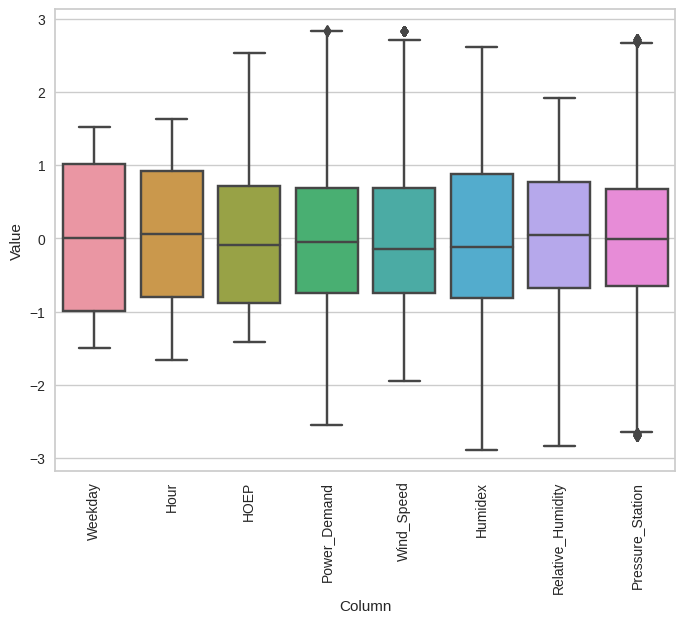

In [156]:
df_melt_rm_ol = df_scaled_rm_ol.melt(var_name='Column', value_name='Value')
plt.figure(figsize=(8, 6))
ax = sns.boxplot(x='Column', y='Value', data=df_melt_rm_ol)
_ = ax.set_xticklabels(df_zs.keys(), rotation=90)

Generally, we can classify time series forecasting problems into two categories:

1. Univariate: Involving a single time-dependent variable.
2. Multivariate: Involving more than one time-dependent variable.

In this particular case, the problem at hand is a multivariate time series prediction. I will explore various methods ranging from simple to advanced and assess their performance.

Here are the different approaches I will consider:

- Classical/Statistical Models: Moving Averages, Exponential Smoothing, ARIMA, SARIMA, and TBATS.
- Machine Learning: Linear Regression, XGBoost, Random Forest.
- Deep Learning: RNN, LSTM.


**Reggression Model**

In regression methods, time series data can be viewed as observations and labels, making it suitable for fitting regression models.

In [ ]:
from pycaret.regression import *

In [ ]:
df['Year'] = df['Date'].dt.year
df['Month'] = df['Date'].dt.month
df['Day'] = df['Date'].dt.day
df = df.drop(columns=['Date'])

KeyError: ignored

In [ ]:
# split dataset to train and test
n = len(df)
train_df = df[0:int(n*0.8)]
test_df = df[int(n*0.8):]

num_features = df.shape[1]

In [ ]:
# initialize setup
s = setup(data = train_df, test_data = test_df, target = 'Power_Demand', fold_strategy = 'timeseries'
, numeric_features = ['Year', 'Month','Day','Hour','HOEP','Temperature','Windchill_Index','Wind_Speed','Humidex','Relative_Humidity','Dew_Point', 'Pressure_Station']
,categorical_features=['Weekday'] , fold = 3, transform_target = True,normalize = True, transformation = True, session_id = 123)

,Description,Value
0,Session id,123
1,Target,Power_Demand
2,Target type,Regression
3,Original data shape,"(39405, 15)"
4,Transformed data shape,"(39405, 23)"
5,Transformed train set shape,"(31524, 23)"
6,Transformed test set shape,"(7881, 23)"
7,Numeric features,12
8,Date features,1
9,Categorical features,1


In [ ]:
best = compare_models(sort = 'MAE')

,Model,MAE,MSE,RMSE,R2,RMSLE,MAPE,TT (Sec)
lightgbm,Light Gradient Boosting Machine,478.3714,391804.5964,623.2081,0.9072,0.0400,0.0312,0.8267
et,Extra Trees Regressor,494.6109,427347.9153,651.7000,0.8990,0.0416,0.0321,7.3400
xgboost,Extreme Gradient Boosting,500.4376,423681.9266,649.1242,0.8998,0.0417,0.0327,2.8767
rf,Random Forest Regressor,525.8918,482880.7770,691.8410,0.8858,0.0442,0.0341,13.6600
gbr,Gradient Boosting Regressor,531.9762,472915.9309,686.6149,0.8884,0.0441,0.0347,4.2600
dt,Decision Tree Regressor,732.8643,948979.9334,970.2443,0.7754,0.0622,0.0475,1.6233
ada,AdaBoost Regressor,792.0919,945142.7377,972.0779,0.7787,0.0627,0.0514,2.8667
knn,K Neighbors Regressor,894.0542,1306582.6717,1141.1761,0.6921,0.0737,0.0585,1.8867
lr,Linear Regression,1017.9512,1611217.9461,1269.2890,0.6227,0.0820,0.0660,3.5100
br,Bayesian Ridge,1024.5810,1623743.7450,1274.2228,0.6198,0.0822,0.0673,0.8533


Processing:   0%|          | 0/81 [00:00<?, ?it/s]

In [ ]:
# best = lightgbm
predictions_test = predict_model(best, data=test_df)

NameError: ignored

In [ ]:
predictions_test

,Weekday,Hour,HOEP,Temperature,Windchill_Index,Wind_Speed,Humidex,Relative_Humidity,Dew_Point,Pressure_Station,Year,Month,Day,Power_Demand,prediction_label
31526,Thursday,21,22.520000,-2.6,-8.52,20,-5.71,79,-5.7,100.370003,2020,1,30,19.118855,18891.200259
31527,Thursday,22,21.370001,-2.6,-8.68,21,-5.79,76,-6.2,100.349998,2020,1,30,18.998053,18158.679368
31528,Thursday,23,19.160000,-2.9,-9.21,22,-6.08,74,-6.8,100.330002,2020,1,30,18.809331,17189.881694
31529,Friday,0,14.980000,-3.0,-5.89,7,-6.40,75,-6.8,100.339996,2020,1,31,18.496166,15912.968699
31530,Friday,1,16.730000,-3.0,-8.51,17,-6.37,76,-6.6,100.330002,2020,1,31,18.452489,15067.371152
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
39403,Thursday,19,36.849998,0.2,-4.02,13,-2.69,74,-3.8,100.660004,2020,12,31,18.883429,17927.027345
39404,Thursday,20,19.690001,-0.2,-5.59,16,-3.58,65,-6.0,100.760002,2020,12,31,18.766806,17367.424654
39405,Thursday,21,20.780001,-3.0,-7.44,12,-3.67,80,-6.0,100.809998,2020,12,31,18.640758,17639.032529
39406,Thursday,22,27.850000,-0.8,-6.76,17,-4.11,70,-5.6,100.900002,2020,12,31,18.556260,16936.981298


In [ ]:
tuned_best = tune_model(best, optimize = 'MSE')

,MAE,MSE,RMSE,R2,RMSLE,MAPE
Fold,,,,,,
0,577.0093,549389.4766,741.2081,0.8574,0.0484,0.0381
1,480.2017,391969.9447,626.0750,0.9153,0.0397,0.0310
2,437.8163,337103.1539,580.6059,0.9233,0.0369,0.0283
Mean,498.3424,426154.1917,649.2963,0.8987,0.0417,0.0325
Std,58.2551,89973.3026,67.5904,0.0294,0.0049,0.0042


Processing:   0%|          | 0/7 [00:00<?, ?it/s]

Fitting 3 folds for each of 10 candidates, totalling 30 fits


Original model was better than the tuned model, hence it will be returned. NOTE: The display metrics are for the tuned model (not the original one).


In [ ]:
evaluate_model(best)

interactive(children=(ToggleButtons(description='Plot Type:', icons=('',), options=(('Pipeline Plot', 'pipelin…

In [ ]:
# ax = predictions_test['Power_Demand'].plot.line(figsize=(15, 5))
# predictions_test['prediction_label'].div(1000).plot.line(ax=ax)
# plt.legend(['Truth Data', 'Predictions'])
# ax.set_title('Raw Data and Prediction')
# plt.show()

**RNN Based - LSTM**

Now we will use RNN model for timeseries predicition. 


**Single Shot LSTM Model**

Make the predictions all at once.

In [ ]:
# create datetime onject based on date and hour
def combine_date_hour(row):
  return row['Date'] + pd.Timedelta(row['Hour'],'h') 

In [ ]:
df_orginal

,Weekday,Hour,HOEP,Power_Demand,Temperature,Windchill_Index,Wind_Speed,Humidex,Relative_Humidity,Dew_Point,Pressure_Station
Date,,,,,,,,,,,
2016-01-01,Friday,0,0.49,14023,-0.3,-5.62,20,-3.18,70,-5.1,99.67
2016-01-01,Friday,1,-1.09,13417,-0.3,-6.30,25,-3.48,68,-5.5,99.63
2016-01-01,Friday,2,-2.41,12968,-0.4,-6.55,26,-3.43,73,-4.7,99.59
2016-01-01,Friday,12,0.00,14215,-2.1,-8.72,23,-4.86,76,-5.8,99.39
2016-01-01,Friday,13,0.00,14443,-2.4,-8.23,19,-5.09,84,-4.7,99.35
...,...,...,...,...,...,...,...,...,...,...,...
2020-12-31,Thursday,19,36.85,17384,0.2,-4.02,13,-2.69,74,-3.8,100.66
2020-12-31,Thursday,20,19.69,16783,-0.2,-5.59,16,-3.58,65,-6.0,100.76
2020-12-31,Thursday,21,20.78,16154,-3.0,-7.44,12,-3.67,80,-6.0,100.81


In [ ]:
df = df_orginal
df.reset_index(inplace=True)
df['Date_Time']= df.apply(combine_date_hour,axis=1)
df.head()

,Date,Weekday,Hour,HOEP,Power_Demand,Temperature,Windchill_Index,Wind_Speed,Humidex,Relative_Humidity,Dew_Point,Pressure_Station,Date_Time
0,2016-01-01,Friday,0,0.49,14023,-0.3,-5.62,20,-3.18,70,-5.1,99.67,2016-01-01 00:00:00
1,2016-01-01,Friday,1,-1.09,13417,-0.3,-6.30,25,-3.48,68,-5.5,99.63,2016-01-01 01:00:00
2,2016-01-01,Friday,2,-2.41,12968,-0.4,-6.55,26,-3.43,73,-4.7,99.59,2016-01-01 02:00:00
3,2016-01-01,Friday,12,0.00,14215,-2.1,-8.72,23,-4.86,76,-5.8,99.39,2016-01-01 12:00:00
4,2016-01-01,Friday,13,0.00,14443,-2.4,-8.23,19,-5.09,84,-4.7,99.35,2016-01-01 13:00:00


In [ ]:
df.columns

Index(['Date', 'Weekday', 'Hour', 'HOEP', 'Power_Demand', 'Temperature',
       'Windchill_Index', 'Wind_Speed', 'Humidex', 'Relative_Humidity',
       'Dew_Point', 'Pressure_Station', 'Date_Time'],
      dtype='object')

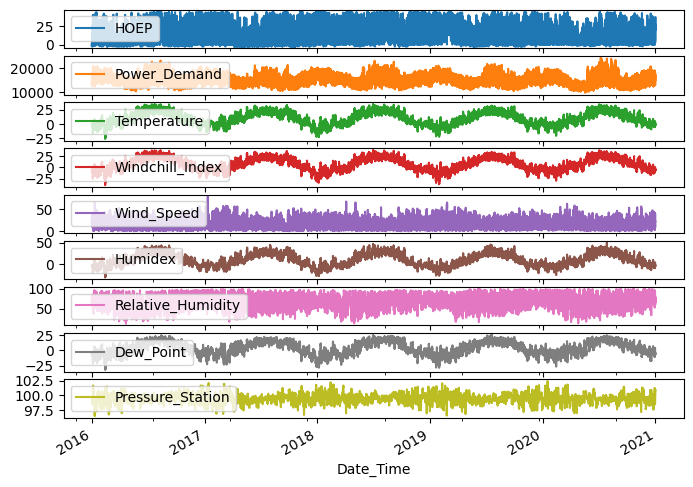

In [ ]:
plot_cols = ['HOEP', 'Power_Demand', 'Temperature','Windchill_Index', 
             'Wind_Speed', 'Humidex', 'Relative_Humidity',
              'Dew_Point', 'Pressure_Station']

plot_features = df[plot_cols]
plot_features.index = df['Date_Time']
_ = plot_features.plot(subplots=True)


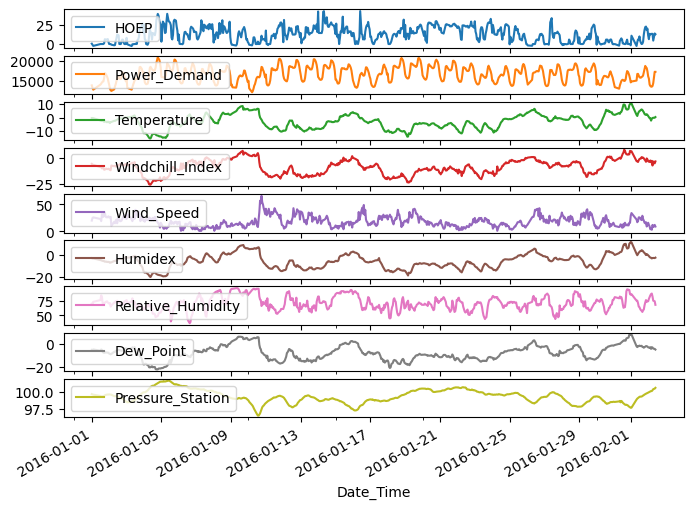

In [ ]:
plot_features = df[plot_cols][:720]
plot_features.index = df['Date_Time'][:720]
_ = plot_features.plot(subplots=True)

<ipython-input-10-609ce31a8c74>:1: FutureWarning: The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  df.set_index('Date_Time', inplace=False).drop(columns=['Hour']).resample('M').mean().plot(subplots=True)


array([<Axes: xlabel='Date_Time'>, <Axes: xlabel='Date_Time'>,
       <Axes: xlabel='Date_Time'>, <Axes: xlabel='Date_Time'>,
       <Axes: xlabel='Date_Time'>, <Axes: xlabel='Date_Time'>,
       <Axes: xlabel='Date_Time'>, <Axes: xlabel='Date_Time'>,
       <Axes: xlabel='Date_Time'>], dtype=object)

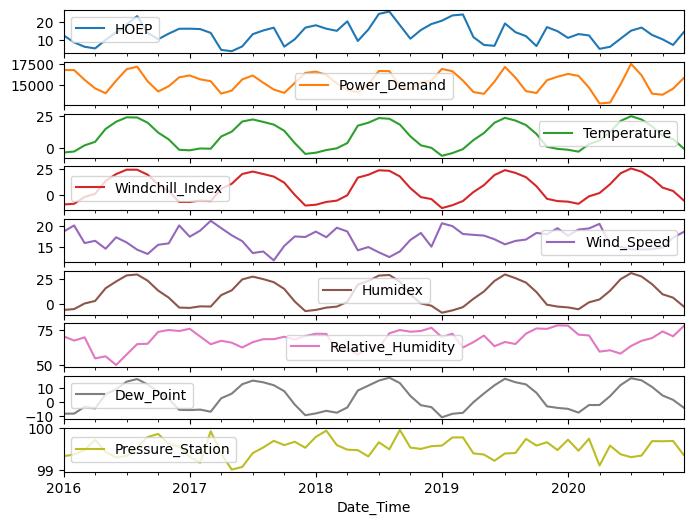

In [ ]:
df.set_index('Date_Time', inplace=False).drop(columns=['Hour']).resample('M').mean().plot(subplots=True)

In [ ]:
df.describe().transpose()

,count,mean,std,min,25%,50%,75%,max
Hour,39408.0,11.625076,6.945136,0.00,6.00,12.00,18.00,23.00
HOEP,39408.0,13.923340,11.902378,-2.77,3.30,12.95,22.51,44.11
Power_Demand,39408.0,15397.914205,2201.241563,9831.00,13775.00,15272.00,16881.00,24281.00
Temperature,39408.0,9.421272,10.899602,-26.00,0.80,8.60,19.00,35.10
Windchill_Index,39408.0,6.565978,13.513148,-39.66,-3.95,5.67,18.58,37.94
Wind_Speed,39408.0,16.854243,9.220125,0.00,10.00,16.00,22.00,80.00
Humidex,39408.0,9.859521,14.325742,-31.10,-1.68,7.86,22.35,50.35
Relative_Humidity,39408.0,68.028598,16.773789,13.00,57.00,69.00,81.00,100.00
Dew_Point,39408.0,3.330397,10.269080,-31.60,-4.40,3.00,12.10,25.10
Pressure_Station,39408.0,99.533605,0.776696,96.49,99.05,99.54,100.04,102.41


In [ ]:
df.isnull().sum()

Date                 0
Weekday              0
Hour                 0
HOEP                 0
Power_Demand         0
Temperature          0
Windchill_Index      0
Wind_Speed           0
Humidex              0
Relative_Humidity    0
Dew_Point            0
Pressure_Station     0
Date_Time            0
dtype: int64

In [ ]:
# remove duplicate indexes
df.drop_duplicates(subset=['Date_Time'], inplace=True)

In [ ]:
# complete the time series, fill the missing datapoints with the nearest available point 
start_date = df['Date_Time'].min()
end_date = df['Date_Time'].max()

df_c = df.set_index(['Date_Time'])
df_c = df_c.reindex(pd.date_range(start_date, end_date, freq='H'), method='nearest')

In [ ]:
df_c.index

DatetimeIndex(['2016-01-01 00:00:00', '2016-01-01 01:00:00',
               '2016-01-01 02:00:00', '2016-01-01 03:00:00',
               '2016-01-01 04:00:00', '2016-01-01 05:00:00',
               '2016-01-01 06:00:00', '2016-01-01 07:00:00',
               '2016-01-01 08:00:00', '2016-01-01 09:00:00',
               ...
               '2020-12-31 14:00:00', '2020-12-31 15:00:00',
               '2020-12-31 16:00:00', '2020-12-31 17:00:00',
               '2020-12-31 18:00:00', '2020-12-31 19:00:00',
               '2020-12-31 20:00:00', '2020-12-31 21:00:00',
               '2020-12-31 22:00:00', '2020-12-31 23:00:00'],
              dtype='datetime64[ns]', length=43848, freq='H')

Text(0.5, 1.0, 'Time of day signal')

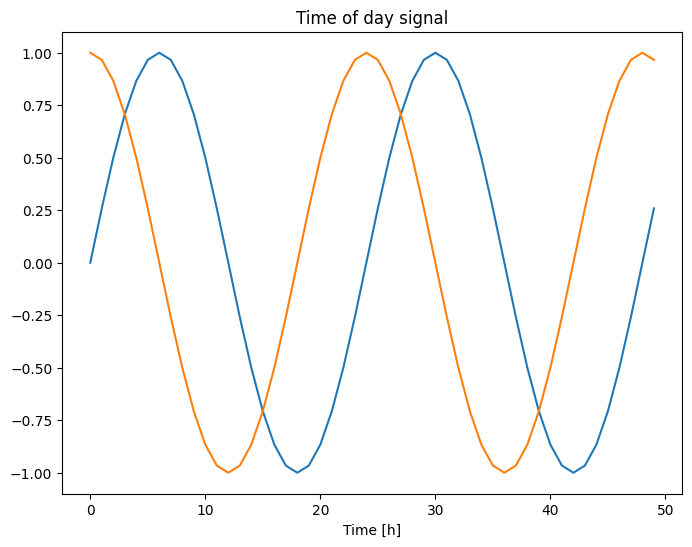

In [ ]:
# demand data has clear daily and yearly periodicity
# get signals by using sine and cosine transforms of time to create "Time of day" and "Time of year" signals
date_time = df_c.index
timestamp_s = date_time.map(pd.Timestamp.timestamp)

day = 24*60*60
year = (365.2425)*day

df_c['Day sin'] = np.sin(timestamp_s * (2 * np.pi / day))
df_c['Day cos'] = np.cos(timestamp_s * (2 * np.pi / day))
df_c['Year sin'] = np.sin(timestamp_s * (2 * np.pi / year))
df_c['Year cos'] = np.cos(timestamp_s * (2 * np.pi / year))

plt.plot(np.array(df_c['Day sin'])[:50])
plt.plot(np.array(df_c['Day cos'])[:50])
plt.xlabel('Time [h]')
plt.title('Time of day signal')

In [ ]:
# handeling categorical variables
days = {'Monday':0, 'Tuesday':1, 'Wednesday':2, 'Thursday':3, 'Friday':4, 'Saturday':5, 'Sunday':6}
df_c['Weekday'] = df_c['Weekday'].map(days)

In [ ]:
df_c.drop(columns=['Date', 'Hour'], inplace=True)
column_indices = {name: i for i, name in enumerate(df_c.columns)}
num_features = df_c.shape[1]

In [ ]:
# use a (70%, 20%, 10%) split for the training, validation, and test sets.
n = len(df_c)
train_df = df_c[0:int(n*0.7)]
val_df = df_c[int(n*0.7):int(n*0.9)]
test_df = df_c[int(n*0.9):]

In [ ]:
df_c

,Weekday,HOEP,Power_Demand,Temperature,Windchill_Index,Wind_Speed,Humidex,Relative_Humidity,Dew_Point,Pressure_Station,Day sin,Day cos,Year sin,Year cos
2016-01-01 00:00:00,4,0.49,14023,-0.3,-5.62,20,-3.18,70,-5.1,99.67,-1.407890e-12,1.000000,-0.002666,0.999996
2016-01-01 01:00:00,4,-1.09,13417,-0.3,-6.30,25,-3.48,68,-5.5,99.63,2.588190e-01,0.965926,-0.001950,0.999998
2016-01-01 02:00:00,4,-2.41,12968,-0.4,-6.55,26,-3.43,73,-4.7,99.59,5.000000e-01,0.866025,-0.001233,0.999999
2016-01-01 03:00:00,4,-2.41,12968,-0.4,-6.55,26,-3.43,73,-4.7,99.59,7.071068e-01,0.707107,-0.000516,1.000000
2016-01-01 04:00:00,4,-2.41,12968,-0.4,-6.55,26,-3.43,73,-4.7,99.59,8.660254e-01,0.500000,0.000201,1.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2020-12-31 19:00:00,3,36.85,17384,0.2,-4.02,13,-2.69,74,-3.8,100.66,-9.659258e-01,0.258819,0.007297,0.999973
2020-12-31 20:00:00,3,19.69,16783,-0.2,-5.59,16,-3.58,65,-6.0,100.76,-8.660254e-01,0.500000,0.008014,0.999968
2020-12-31 21:00:00,3,20.78,16154,-3.0,-7.44,12,-3.67,80,-6.0,100.81,-7.071068e-01,0.707107,0.008730,0.999962
2020-12-31 22:00:00,3,27.85,15744,-0.8,-6.76,17,-4.11,70,-5.6,100.90,-5.000000e-01,0.866025,0.009447,0.999955


Single output LSTM

In [ ]:
df_input = df_c.reset_index(drop=True)

In [ ]:
df_input

,Weekday,HOEP,Power_Demand,Temperature,Windchill_Index,Wind_Speed,Humidex,Relative_Humidity,Dew_Point,Pressure_Station,Day sin,Day cos,Year sin,Year cos
0,4,0.49,14023,-0.3,-5.62,20,-3.18,70,-5.1,99.67,-1.407890e-12,1.000000,-0.002666,0.999996
1,4,-1.09,13417,-0.3,-6.30,25,-3.48,68,-5.5,99.63,2.588190e-01,0.965926,-0.001950,0.999998
2,4,-2.41,12968,-0.4,-6.55,26,-3.43,73,-4.7,99.59,5.000000e-01,0.866025,-0.001233,0.999999
3,4,-2.41,12968,-0.4,-6.55,26,-3.43,73,-4.7,99.59,7.071068e-01,0.707107,-0.000516,1.000000
4,4,-2.41,12968,-0.4,-6.55,26,-3.43,73,-4.7,99.59,8.660254e-01,0.500000,0.000201,1.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
43843,3,36.85,17384,0.2,-4.02,13,-2.69,74,-3.8,100.66,-9.659258e-01,0.258819,0.007297,0.999973
43844,3,19.69,16783,-0.2,-5.59,16,-3.58,65,-6.0,100.76,-8.660254e-01,0.500000,0.008014,0.999968
43845,3,20.78,16154,-3.0,-7.44,12,-3.67,80,-6.0,100.81,-7.071068e-01,0.707107,0.008730,0.999962
43846,3,27.85,15744,-0.8,-6.76,17,-4.11,70,-5.6,100.90,-5.000000e-01,0.866025,0.009447,0.999955


In [ ]:
#df_input.drop(columns=['ds'], inplace=True)
#df_input

In [ ]:
from sklearn.preprocessing import MinMaxScaler
scaler = MinMaxScaler()
data_scaled = scaler.fit_transform(df_input)

In [ ]:
data_scaled

array([[0.66666667, 0.06953925, 0.29010381, ..., 1.        , 0.49866679,
        0.99999822],
       [0.66666667, 0.03583618, 0.24816609, ..., 0.98296291, 0.49902518,
        0.99999905],
       [0.66666667, 0.00767918, 0.21709343, ..., 0.9330127 , 0.49938357,
        0.99999962],
       ...,
       [0.5       , 0.50234642, 0.43757785, ..., 0.85355339, 0.50436515,
        0.99998095],
       [0.5       , 0.653157  , 0.40920415, ..., 0.9330127 , 0.50472353,
        0.99997769],
       [0.5       , 0.47888225, 0.36408304, ..., 0.98296291, 0.5050819 ,
        0.99997417]])

In [ ]:
features=data_scaled
target=data_scaled[:, 2]

In [ ]:
from sklearn.model_selection import train_test_split
x_train, x_test, y_train, y_test = train_test_split(features, target, test_size=0.2, random_state=123, shuffle=False)

In [ ]:
from keras.preprocessing.sequence import TimeseriesGenerator
window_length = 72
batch_size = 32
train_generator = TimeseriesGenerator(x_train, y_train, length=window_length, sampling_rate=1, batch_size=batch_size)
test_generator = TimeseriesGenerator(x_test, y_test, length=window_length, sampling_rate=1, batch_size=batch_size)

In [ ]:
train_generator[0]

(array([[[0.66666667, 0.06953925, 0.29010381, ..., 1.        ,
          0.49866679, 0.99999822],
         [0.66666667, 0.03583618, 0.24816609, ..., 0.98296291,
          0.49902518, 0.99999905],
         [0.66666667, 0.00767918, 0.21709343, ..., 0.9330127 ,
          0.49938357, 0.99999962],
         ...,
         [1.        , 0.54180887, 0.56574394, ..., 0.85355339,
          0.52338724, 0.99945274],
         [1.        , 0.62841297, 0.52013841, ..., 0.9330127 ,
          0.52374523, 0.99943585],
         [1.        , 0.37137372, 0.46885813, ..., 0.98296291,
          0.52410321, 0.9994187 ]],
 
        [[0.66666667, 0.03583618, 0.24816609, ..., 0.98296291,
          0.49902518, 0.99999905],
         [0.66666667, 0.00767918, 0.21709343, ..., 0.9330127 ,
          0.49938357, 0.99999962],
         [0.66666667, 0.00767918, 0.21709343, ..., 0.85355339,
          0.49974196, 0.99999993],
         ...,
         [1.        , 0.62841297, 0.52013841, ..., 0.9330127 ,
          0.52374523, 0.

In [ ]:
model = tf.keras.Sequential()
model.add(tf.keras.layers.LSTM(128, input_shape=(window_length, num_features), return_sequences=True))
model.add(tf.keras.layers.LeakyReLU(alpha=0.5))
model.add(tf.keras.layers.LSTM(128, return_sequences=True))
model.add(tf.keras.layers.LeakyReLU(alpha=0.5))
model.add(tf.keras.layers.Dropout(0.3))
model.add(tf.keras.layers.LSTM(64, return_sequences=False))
model.add(tf.keras.layers.Dropout(0.3))
model.add(tf.keras.layers.Dense(1))

In [ ]:
model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 72, 128)           73216     
                                                                 
 leaky_re_lu (LeakyReLU)     (None, 72, 128)           0         
                                                                 
 lstm_1 (LSTM)               (None, 72, 128)           131584    
                                                                 
 leaky_re_lu_1 (LeakyReLU)   (None, 72, 128)           0         
                                                                 
 dropout (Dropout)           (None, 72, 128)           0         
                                                                 
 lstm_2 (LSTM)               (None, 64)                49408     
                                                                 
 dropout_1 (Dropout)         (None, 64)                0

In [ ]:
early_stopping = tf.keras.callbacks.EarlyStopping(monitor='val_loss',
                                                  patience=2,
                                                  mode='min')

model.compile(loss=tf.keras.losses.MeanSquaredError(),
              optimizer=tf.keras.optimizers.Adam(),
              metrics=[tf.keras.metrics.MeanAbsoluteError(),
                        tf.keras.metrics.MeanAbsolutePercentageError()])

history = model.fit_generator(train_generator, epochs=10,
                    validation_data=test_generator,
                    shuffle=False,
                    callbacks=[early_stopping])

Epoch 1/10


<ipython-input-23-f49d3c678385>:10: UserWarning: `Model.fit_generator` is deprecated and will be removed in a future version. Please use `Model.fit`, which supports generators.
  history = model.fit_generator(train_generator, epochs=10,


1094/1094 [==============================] - 356s 314ms/step - loss: 0.0106 - mean_absolute_error: 0.0775 - mean_absolute_percentage_error: 22.3208 - val_loss: 0.0150 - val_mean_absolute_error: 0.0951 - val_mean_absolute_percentage_error: 22792.6113
Epoch 2/10
1094/1094 [==============================] - 365s 333ms/step - loss: 0.0052 - mean_absolute_error: 0.0553 - mean_absolute_percentage_error: 15.9771 - val_loss: 0.0105 - val_mean_absolute_error: 0.0805 - val_mean_absolute_percentage_error: 17244.5312
Epoch 3/10
1094/1094 [==============================] - 359s 328ms/step - loss: 0.0036 - mean_absolute_error: 0.0461 - mean_absolute_percentage_error: 13.4248 - val_loss: 0.0071 - val_mean_absolute_error: 0.0666 - val_mean_absolute_percentage_error: 12726.8896
Epoch 4/10
1094/1094 [==============================] - 340s 310ms/step - loss: 0.0025 - mean_absolute_error: 0.0380 - mean_absolute_percentage_error: 11.1568 - val_loss: 0.0060 - val_mean_absolute_error: 0.0602 - val_mean_absol

In [ ]:
predictions = model.predict(test_generator)

272/272 [==============================] - 42s 139ms/step


In [ ]:
predictions.shape

(8698, 1)

In [ ]:
y_test.shape

(8770,)

In [ ]:
x_test.shape

(8770, 14)

In [ ]:
df_pred = pd.concat([pd.DataFrame(predictions), pd.DataFrame(x_test[window_length:])], axis=1)

In [ ]:
df_pred.head()
print(df_pred[2].shape)
print(df_pred[0].shape)

(8698,)
(8698, 2)


In [ ]:
df_pred[0].head()

,0,0
0,0.404725,0.833333
1,0.406282,0.833333
2,0.413150,0.833333
3,0.433860,0.833333
4,0.474015,0.833333


In [ ]:
df_pred.drop([2], inplace=True)
df_pred.head()

,0,0,1,2,3,4,5,6,7,8,9,10,11,12,13
0,0.404725,0.833333,0.504693,0.435433,0.461538,0.461469,0.3125,0.375322,0.632184,0.504409,0.347973,0.250000,0.066987,0.529729,0.999115
1,0.406282,0.833333,0.343430,0.432595,0.458265,0.471005,0.2625,0.379251,0.655172,0.506173,0.353041,0.146447,0.146447,0.530087,0.999094
3,0.433860,0.833333,0.161476,0.471211,0.450082,0.459536,0.2875,0.364641,0.620690,0.486772,0.366554,0.017037,0.370590,0.530802,0.999050
4,0.474015,0.833333,0.343857,0.515017,0.441899,0.463660,0.2250,0.367342,0.724138,0.507937,0.381757,0.000000,0.500000,0.531160,0.999028
5,0.502976,0.833333,0.263865,0.488166,0.438625,0.454897,0.2500,0.360344,0.735632,0.506173,0.391892,0.017037,0.629410,0.531518,0.999006


Multi Output LSTM

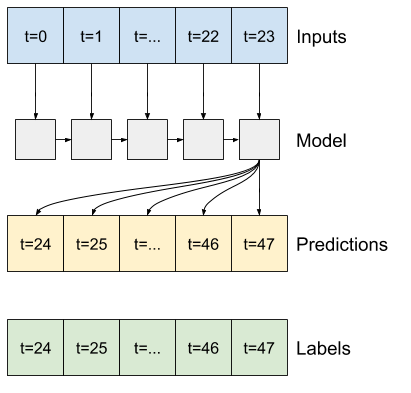

In [ ]:
from IPython.display import Image, display
display(Image('/content/drive/MyDrive/Colab Notebooks/CamrosTech/multistep_lstm.png'))

In [ ]:
# normalize data
train_mean = train_df.mean()
train_std = train_df.std()

train_df = (train_df - train_mean) / train_std
val_df = (val_df - train_mean) / train_std
test_df = (test_df - train_mean) / train_std
train_df.head()

,Weekday,HOEP,Power_Demand,Temperature,Windchill_Index,Wind_Speed,Humidex,Relative_Humidity,Dew_Point,Pressure_Station,Day sin,Day cos,Year sin,Year cos
2016-01-01 00:00:00,0.499161,-1.048438,-0.665868,-0.822075,-0.833127,0.344657,-0.846949,0.163991,-0.731526,0.167482,-0.000068,1.414339,-0.133466,1.414088
2016-01-01 01:00:00,0.499161,-1.165250,-0.946238,-0.822075,-0.882036,0.867499,-0.867528,0.044746,-0.769187,0.116266,0.365944,1.366151,-0.132444,1.414090
2016-01-01 02:00:00,0.499161,-1.262840,-1.153972,-0.831003,-0.900017,0.972067,-0.864098,0.342857,-0.693866,0.065051,0.707012,1.224869,-0.131422,1.414092
2016-01-01 03:00:00,0.499161,-1.262840,-1.153972,-0.831003,-0.900017,0.972067,-0.864098,0.342857,-0.693866,0.065051,0.999894,1.000123,-0.130399,1.414093
2016-01-01 04:00:00,0.499161,-1.262840,-1.153972,-0.831003,-0.900017,0.972067,-0.864098,0.342857,-0.693866,0.065051,1.224630,0.707228,-0.129377,1.414093


In [ ]:
# from sklearn.preprocessing import StandardScaler
# scaler = StandardScaler()
# scaler.fit(train_df)
# train_scaled = scaler.transform(train_df)
# test_scaled = scaler.transform(test_df)
# scaled_val = scaler.transform(val_df)

# pd.DataFrame(train_scaled).head()

In [ ]:
train_df.head()

,Weekday,HOEP,Power_Demand,Temperature,Windchill_Index,Wind_Speed,Humidex,Relative_Humidity,Dew_Point,Pressure_Station,Day sin,Day cos,Year sin,Year cos
2016-01-01 00:00:00,0.499161,-1.048438,-0.665868,-0.822075,-0.833127,0.344657,-0.846949,0.163991,-0.731526,0.167482,-0.000068,1.414339,-0.133466,1.414088
2016-01-01 01:00:00,0.499161,-1.165250,-0.946238,-0.822075,-0.882036,0.867499,-0.867528,0.044746,-0.769187,0.116266,0.365944,1.366151,-0.132444,1.414090
2016-01-01 02:00:00,0.499161,-1.262840,-1.153972,-0.831003,-0.900017,0.972067,-0.864098,0.342857,-0.693866,0.065051,0.707012,1.224869,-0.131422,1.414092
2016-01-01 03:00:00,0.499161,-1.262840,-1.153972,-0.831003,-0.900017,0.972067,-0.864098,0.342857,-0.693866,0.065051,0.999894,1.000123,-0.130399,1.414093
2016-01-01 04:00:00,0.499161,-1.262840,-1.153972,-0.831003,-0.900017,0.972067,-0.864098,0.342857,-0.693866,0.065051,1.224630,0.707228,-0.129377,1.414093


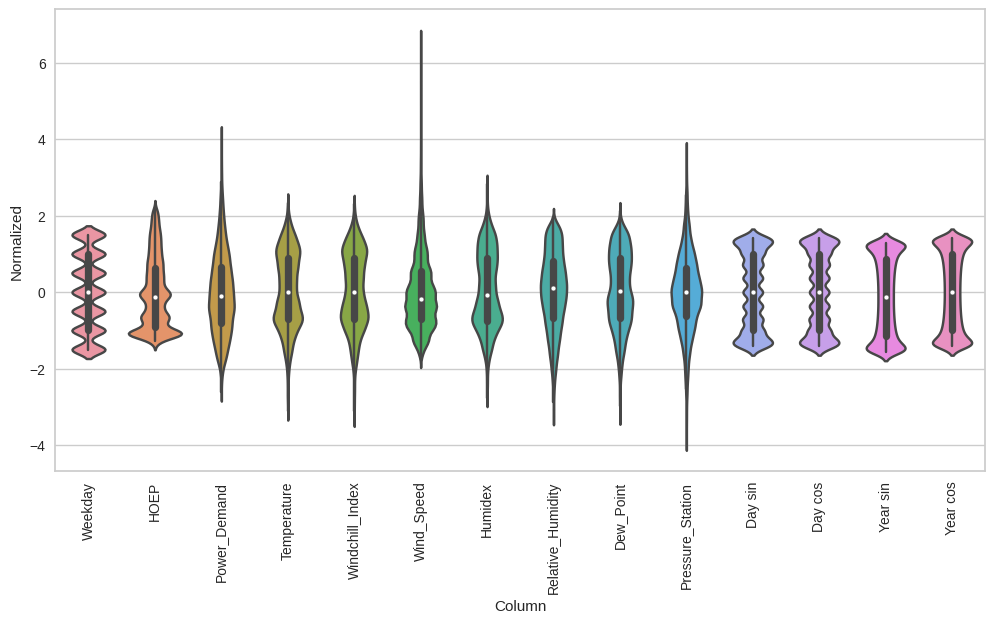

In [ ]:
# check features' distribution
df_std = (df_c - train_mean) / train_std
df_std = df_std.melt(var_name='Column', value_name='Normalized')
plt.figure(figsize=(12, 6))
ax = sns.violinplot(x='Column', y='Normalized', data=df_std)
_ = ax.set_xticklabels(df_c.keys(), rotation=90)

In [ ]:
# data windowing - create dataset based on tensorflow dataset object, considering
# batch_size, length of timeseries and number of features

BATCH_SIZE = 16
class WindowGenerator():
  def __init__(self, input_width, label_width, shift,
               train_df=train_df, val_df=val_df, test_df=test_df,
               label_columns=None):
    # Store the raw data.
    self.train_df = train_df
    self.val_df = val_df
    self.test_df = test_df

    # Work out the label column indices.
    self.label_columns = label_columns
    if label_columns is not None:
      self.label_columns_indices = {name: i for i, name in
                                    enumerate(label_columns)}
    self.column_indices = {name: i for i, name in
                           enumerate(train_df.columns)}

    # Work out the window parameters.
    self.input_width = input_width
    self.label_width = label_width
    self.shift = shift

    self.total_window_size = input_width + shift

    self.input_slice = slice(0, input_width)
    self.input_indices = np.arange(self.total_window_size)[self.input_slice]

    self.label_start = self.total_window_size - self.label_width
    self.labels_slice = slice(self.label_start, None)
    self.label_indices = np.arange(self.total_window_size)[self.labels_slice]

  def __repr__(self):
    return '\n'.join([
        f'Total window size: {self.total_window_size}',
        f'Input indices: {self.input_indices}',
        f'Label indices: {self.label_indices}',
        f'Label column name(s): {self.label_columns}'])
    
  def split_window(self, features):
    inputs = features[:, self.input_slice, :]
    labels = features[:, self.labels_slice, :]
    if self.label_columns is not None:
      labels = tf.stack(
          [labels[:, :, self.column_indices[name]] for name in self.label_columns],
          axis=-1)

    # Slicing doesn't preserve static shape information, so set the shapes
    # manually. This way the `tf.data.Datasets` are easier to inspect.
    inputs.set_shape([None, self.input_width, None])
    labels.set_shape([None, self.label_width, None])

    return inputs, labels

  def plot(self, model=None, plot_col='Power_Demand', max_subplots=3):
    inputs, labels = self.example
    plt.figure(figsize=(12, 8))
    plot_col_index = self.column_indices[plot_col]
    max_n = min(max_subplots, len(inputs))
    for n in range(max_n):
      plt.subplot(max_n, 1, n+1)
      plt.ylabel(f'{plot_col} [normed]')
      plt.plot(self.input_indices, inputs[n, :, plot_col_index],
              label='Inputs', marker='.', zorder=-10)

      if self.label_columns:
        label_col_index = self.label_columns_indices.get(plot_col, None)
      else:
        label_col_index = plot_col_index

      if label_col_index is None:
        continue

      plt.scatter(self.label_indices, labels[n, :, label_col_index],
                  edgecolors='k', label='Labels', c='#2ca02c', s=64)
      if model is not None:
        predictions = model(inputs)
        plt.scatter(self.label_indices, predictions[n, :, label_col_index],
                    marker='X', edgecolors='k', label='Predictions',
                    c='#ff7f0e', s=64)

      if n == 0:
        plt.legend()

    plt.xlabel('Time [h]')

  def make_dataset(self, data):
    data = np.array(data, dtype=np.float32)
    ds = tf.keras.utils.timeseries_dataset_from_array(
        data=data,
        targets=None,
        sequence_length=self.total_window_size,
        sequence_stride=1,
        shuffle=True,
        batch_size=BATCH_SIZE,)

    ds = ds.map(self.split_window)

    return ds

  @property
  def train(self):
    return self.make_dataset(self.train_df)

  @property
  def val(self):
    return self.make_dataset(self.val_df)

  @property
  def test(self):
    return self.make_dataset(self.test_df)

  @property
  def example(self):
    """Get and cache an example batch of `inputs, labels` for plotting."""
    result = getattr(self, '_example', None)
    if result is None:
      # No example batch was found, so get one from the `.train` dataset
      result = next(iter(self.train))
      # And cache it for next time
      self._example = result
    return result


Total window size: 72
Input indices: [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47]
Label indices: [48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63 64 65 66 67 68 69 70 71]
Label column name(s): ['Power_Demand']

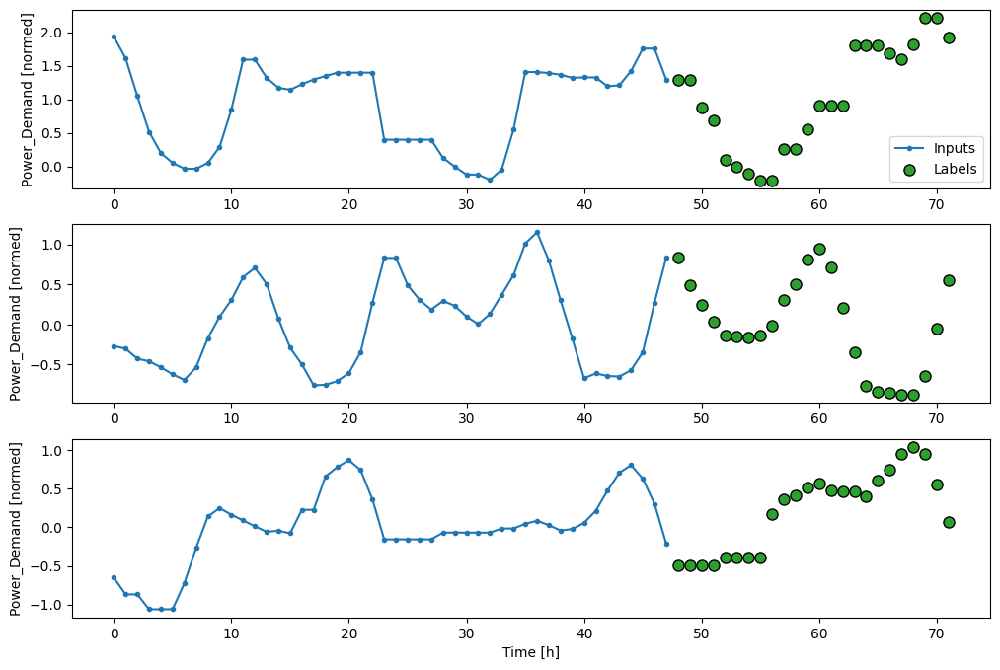

In [ ]:
# create window object for LSTM singleshot prediction 
OUT_STEPS = 24
dataset_ss = WindowGenerator(input_width=48,
                               label_width=OUT_STEPS,
                               shift=OUT_STEPS,
                               label_columns=['Power_Demand'])

dataset_ss.plot()
dataset_ss

In [ ]:
# training function
MAX_EPOCHS = 10

def compile_and_fit(model, window, patience=2):
  early_stopping = tf.keras.callbacks.EarlyStopping(monitor='val_loss',
                                                    patience=patience,
                                                    mode='min')

  model.compile(loss=tf.keras.losses.MeanSquaredError(),
                optimizer=tf.keras.optimizers.Adam(),
                metrics=[tf.keras.metrics.MeanAbsoluteError(),
                         tf.keras.metrics.MeanAbsolutePercentageError()])

  history = model.fit(window.train, epochs=MAX_EPOCHS,
                      validation_data=window.val,
                      callbacks=[early_stopping])
  return history

In [ ]:
# check inputs shapes

print('Train data ->', dataset_ss.train_df.shape)
# print('Number of batches -> ', len(list(dataset_ss.train)))
print('input shape to LSTM ->', next(iter(dataset_ss.train.take(1)))[0].shape)
print('Number of batches -> ', tf.data.experimental.cardinality(dataset_ss.train).numpy())

Train data -> (30693, 14)
input shape to LSTM -> (16, 48, 14)
Number of batches ->  1914


544/544 [==============================] - 4s 8ms/step - loss: 0.1065 - mean_absolute_error: 0.2462 - mean_absolute_percentage_error: 92.8446


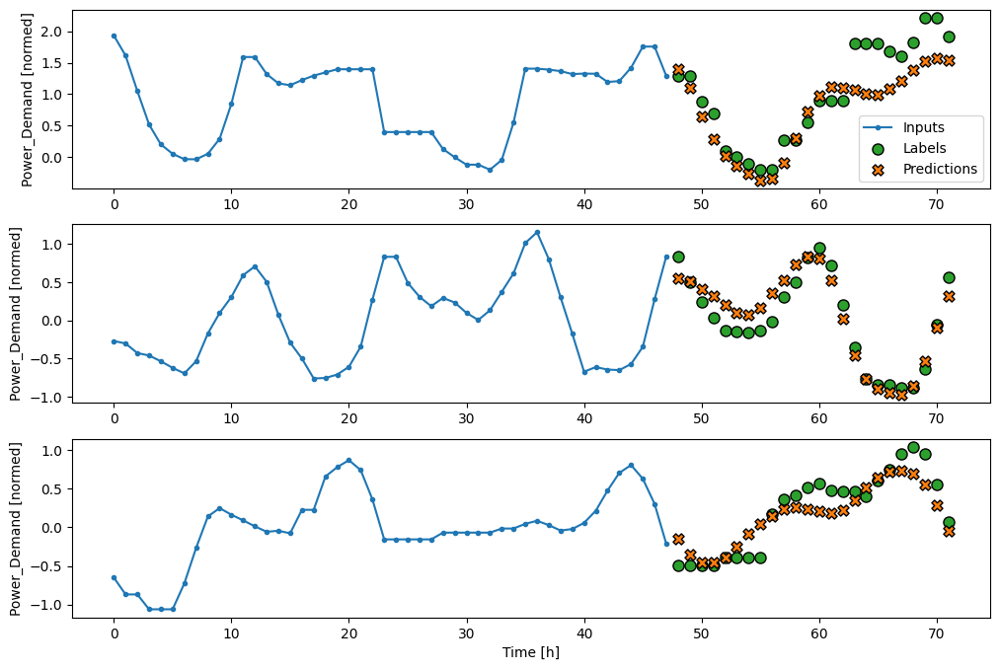

In [ ]:
# create LSTM model for singleshot(24 hours at on shot) prediction

lstm_singleshot = tf.keras.Sequential([
    # Shape [batch, time, features] => [batch, lstm_units].
    # Adding more `lstm_units` just overfits more quickly.
    tf.keras.layers.LSTM(50, return_sequences=False),
    # Shape => [batch, out_steps*features].
    tf.keras.layers.Dense(OUT_STEPS*num_features,
                          kernel_initializer=tf.initializers.zeros()),
    # Shape => [batch, out_steps, features].
    tf.keras.layers.Reshape([OUT_STEPS, num_features])
])

val_performance = {}
performance = {}

history = compile_and_fit(lstm_singleshot, dataset_ss)

IPython.display.clear_output()

val_performance['LSTM_singleshot'] = lstm_singleshot.evaluate(dataset_ss.val)
performance['LSTM_singleshot'] = lstm_singleshot.evaluate(dataset_ss.test, verbose=0)
dataset_ss.plot(lstm_singleshot)

In [ ]:
from sklearn.metrics import mean_squared_error, mean_absolute_error
def mean_absolute_percentage_error(y_true, y_pred): 
    """Calculates MAPE given y_true and y_pred"""
    y_true, y_pred = np.array(y_true), np.array(y_pred)
    return np.mean(np.abs((y_true - y_pred) / y_true)) * 100

In [ ]:
from datetime import datetime
from datetime import timedelta
def predict_demand(datetime_str='2020-12-22 00:00:00', lookback=48):
  '''
    predict power demand for a sample date in the 'test dataset'
    lookback will configure the number of hours which model will look to generate the response
    - datetime_str in str %Y-%m-%d %H:%M:%S
    - lookback in hours
  '''
  date = datetime.strptime(datetime_str, '%Y-%m-%d %H:%M:%S')
  window = test_df.loc[date - timedelta(hours=lookback): date + timedelta(hours=24-1)]
  input = test_df.loc[date - timedelta(hours=lookback): date - timedelta(hours=1)]
  out = test_df.loc[date : date + timedelta(hours=23-1)]

  pred = lstm_singleshot.predict(np.array(input).reshape((1, lookback, 14)))
  pred_df = pd.DataFrame(pred.reshape((24,14)))

  y_prime = pred_df[pred_df.columns[2]]
  y_prime = pd.concat([input['Power_Demand'], y_prime], axis=0, ignore_index=True)

  y = window['Power_Demand']
  y.reset_index(drop=True)


  plt.plot(window.index, y_prime, label='Pred', marker='.', zorder=-10)
  plt.plot(window.index, y, label='True', marker='.',zorder=-10)
  plt.legend()
  plt.show()
  return mean_absolute_percentage_error(y.iloc[-lookback:], y_prime.iloc[-lookback:])

1/1 [==============================] - 0s 483ms/step


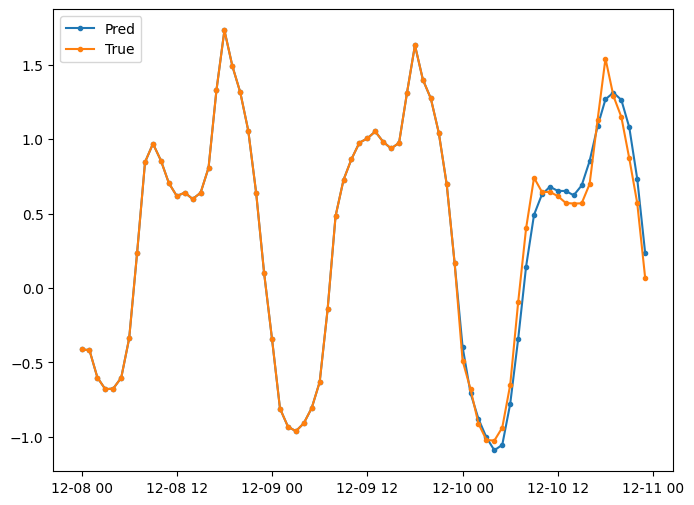

17.28623942860572

In [ ]:
predict_demand('2020-12-10 00:00:00')

In [ ]:
dataset_ss.test_df.shape

(4385, 14)

In [ ]:
res=lstm_singleshot.predict(dataset_ss.test)

270/270 [==============================] - 5s 12ms/step


In [ ]:
res.shape

(4314, 24, 14)

In [ ]:
#test_df.sort_index(inplace=True)
# sample_date = test_df.loc['2020-12-20 00:00:00': '2020-12-22 23:00:00']
# sample_in = sample_date.loc['2020-12-20 00:00:00': '2020-12-21 23:00:00']
# sample_out = sample_date.loc['2020-12-22 00:00:00': '2020-12-22 23:00:00']

**Autoregressive LSTM Model**

Make one prediction at a time and feed the output back to the model.


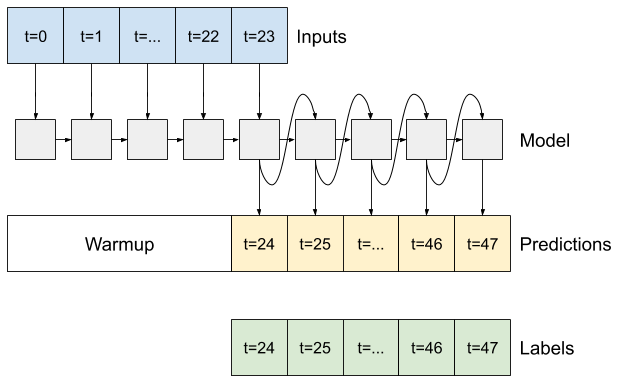

In [ ]:
from IPython.display import Image, display
display(Image('/content/drive/MyDrive/Colab Notebooks/CamrosTech/multistep_autoregressive.png'))

Total window size: 72
Input indices: [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47]
Label indices: [48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63 64 65 66 67 68 69 70 71]
Label column name(s): None

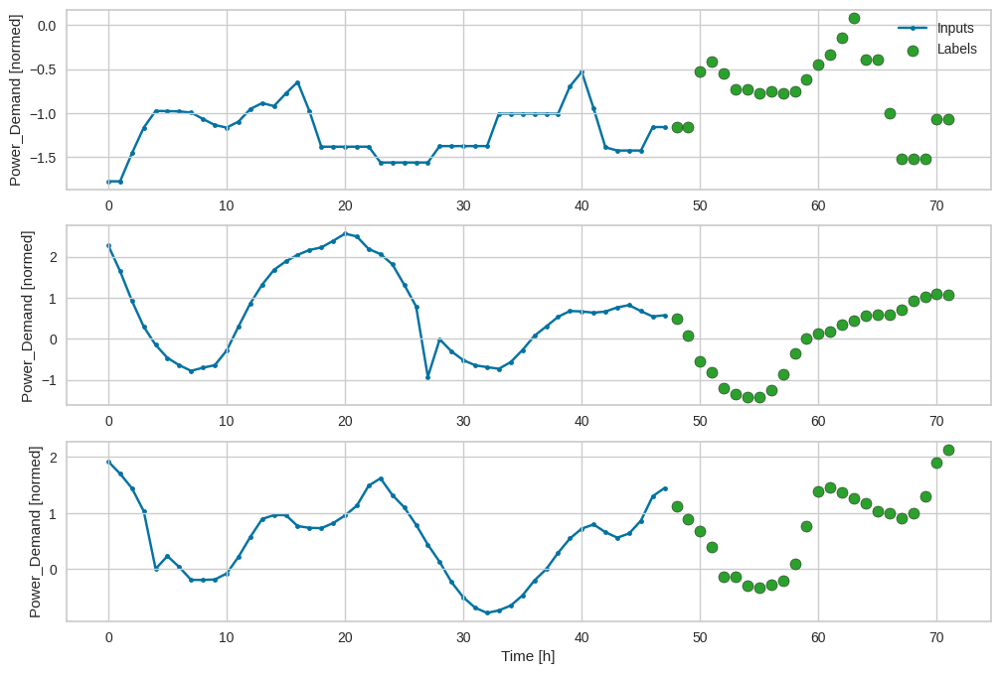

In [ ]:
# autoregressive lstm model
OUT_STEPS = 24
dataset_ar = WindowGenerator(input_width=48,
                               label_width=OUT_STEPS,
                               shift=OUT_STEPS)

dataset_ar.plot()
dataset_ar

In [ ]:
# feedback class
class FeedBack(tf.keras.Model):
  def __init__(self, units, out_steps):
    super().__init__()
    self.out_steps = out_steps
    self.units = units
    self.lstm_cell = tf.keras.layers.LSTMCell(units)
    # wrap the LSTMCell in an RNN to simplify the `warmup` method.
    self.lstm_rnn = tf.keras.layers.RNN(self.lstm_cell, return_state=True)
    self.dense = tf.keras.layers.Dense(num_features)

  def warmup(self, inputs):
    # inputs.shape => (batch, time, features)
    # x.shape => (batch, lstm_units)
    x, *state = self.lstm_rnn(inputs)

    # predictions.shape => (batch, features)
    prediction = self.dense(x)
    return prediction, state

  def call(self, inputs, training=None):
    # Use a TensorArray to capture dynamically unrolled outputs.
    predictions = []
    # Initialize the LSTM state.
    prediction, state = self.warmup(inputs)

    # Insert the first prediction.
    predictions.append(prediction)

    # Run the rest of the prediction steps.
    for n in range(1, self.out_steps):
      # Use the last prediction as input.
      x = prediction
      # Execute one lstm step.
      x, state = self.lstm_cell(x, states=state,
                                training=training)
      # Convert the lstm output to a prediction.
      prediction = self.dense(x)
      # Add the prediction to the output.
      predictions.append(prediction)

    # predictions.shape => (time, batch, features)
    predictions = tf.stack(predictions)
    # predictions.shape => (batch, time, features)
    predictions = tf.transpose(predictions, [1, 0, 2])
    
    return predictions

In [ ]:
feedback_model = FeedBack(units=50, out_steps=OUT_STEPS)

print('Train data ->', dataset_ar.train_df.shape)
print('input shape to LSTM ->', next(iter(dataset_ar.train.take(1)))[0].shape)
print('Number of batches -> ', tf.data.experimental.cardinality(dataset_ar.train).numpy())
print('Output shape (batch, time, features): ', feedback_model(dataset_ar.example[0]).shape)

Train data -> (30693, 14)
input shape to LSTM -> (16, 48, 14)
Number of batches ->  1914
Output shape (batch, time, features):  (16, 24, 14)


Epoch 1/20
1914/1914 [==============================] - 79s 37ms/step - loss: 0.2654 - mean_absolute_error: 0.3446 - mean_absolute_percentage_error: 1961.9822 - val_loss: 0.1926 - val_mean_absolute_error: 0.2868 - val_mean_absolute_percentage_error: 1645.7366
Epoch 2/20
1914/1914 [==============================] - 72s 38ms/step - loss: 0.1863 - mean_absolute_error: 0.2735 - mean_absolute_percentage_error: 1485.5413 - val_loss: 0.1762 - val_mean_absolute_error: 0.2645 - val_mean_absolute_percentage_error: 1342.8210
Epoch 3/20
1914/1914 [==============================] - 76s 40ms/step - loss: 0.1741 - mean_absolute_error: 0.2612 - mean_absolute_percentage_error: 1376.2921 - val_loss: 0.1781 - val_mean_absolute_error: 0.2663 - val_mean_absolute_percentage_error: 1423.3396
Epoch 4/20
1914/1914 [==============================] - 71s 37ms/step - loss: 0.1673 - mean_absolute_error: 0.2548 - mean_absolute_percentage_error: 1360.1964 - val_loss: 0.1741 - val_mean_absolute_error: 0.2603 - val_me

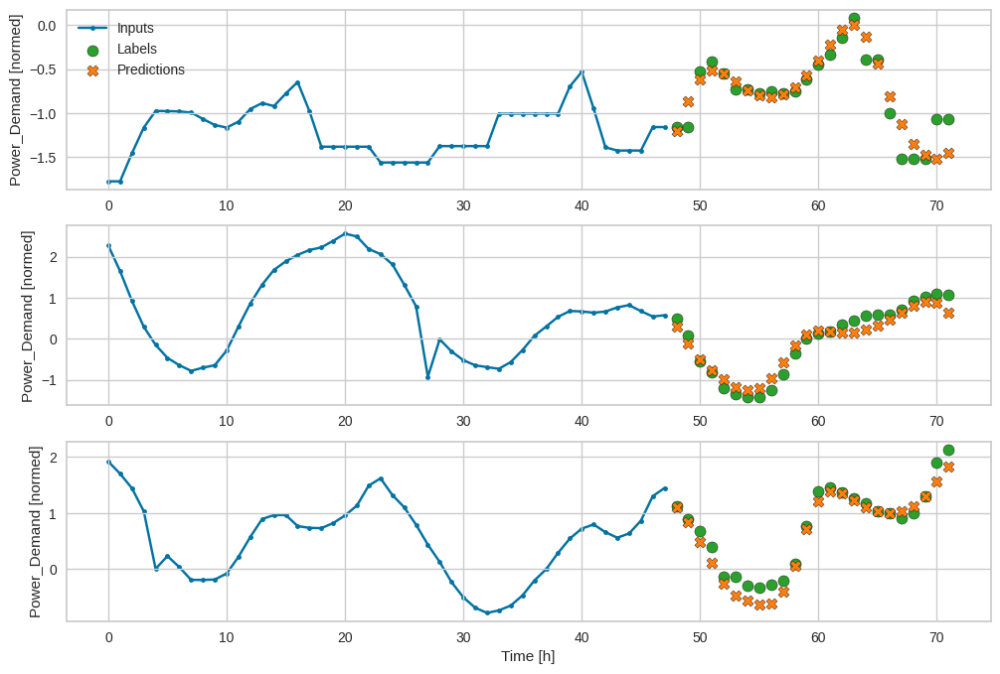

In [ ]:
history = compile_and_fit(feedback_model, dataset_ar)

val_performance['AR LSTM'] = feedback_model.evaluate(dataset_ar.val)
performance['AR LSTM'] = feedback_model.evaluate(dataset_ar.test, verbose=0)
dataset_ar.plot(feedback_model)

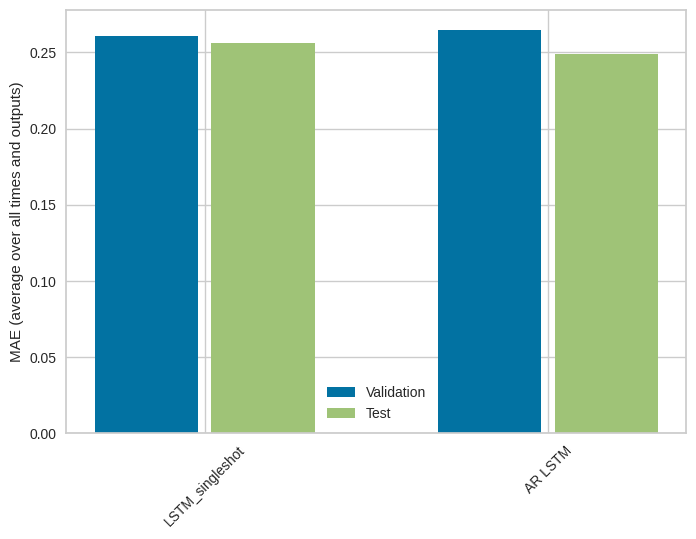

In [ ]:
x = np.arange(len(performance))
width = 0.3

metric_name = 'mean_absolute_error'
metric_index = lstm_singleshot.metrics_names.index('mean_absolute_error')
val_mae = [v[metric_index] for v in val_performance.values()]
test_mae = [v[metric_index] for v in performance.values()]

plt.bar(x - 0.17, val_mae, width, label='Validation')
plt.bar(x + 0.17, test_mae, width, label='Test')
plt.xticks(ticks=x, labels=performance.keys(),
           rotation=45)
plt.ylabel(f'MAE (average over all times and outputs)')
_ = plt.legend()

In [ ]:
# print('label columns:', window_singleshot.label_columns)
# print('label_columns_indices:', window_singleshot.label_columns_indices)
# print('label_indices:', window_singleshot.label_indices)
# print('label_start:', window_singleshot.label_start)
# print('label_width:', window_singleshot.label_width)
# print('column_indices:', window_singleshot.column_indices)

**Statistical Model**

In [ ]:
demand = df_c['Power_Demand']

<Axes: >

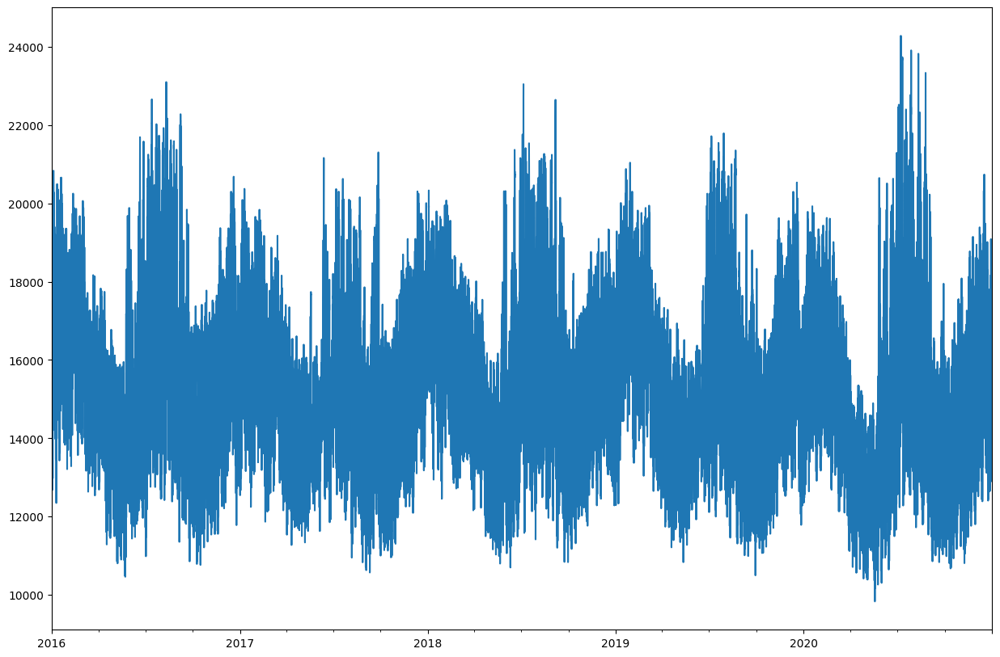

In [ ]:
demand.plot(figsize=(15,10))

array([<Axes: >], dtype=object)

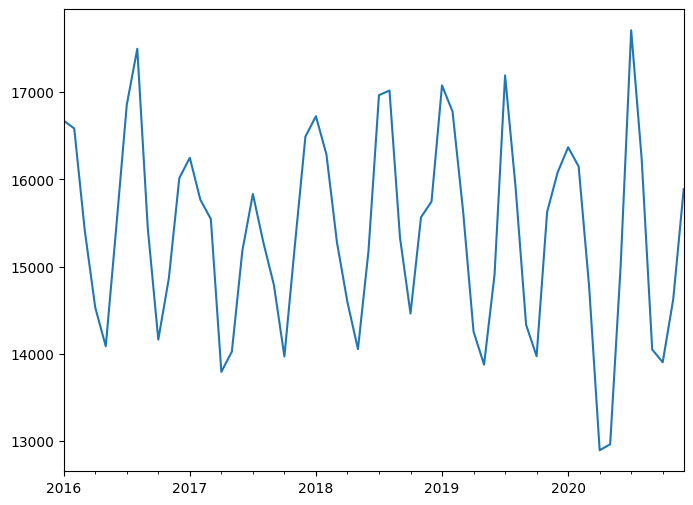

In [ ]:
demand.resample('M').mean().plot(subplots=True)

In [ ]:
from pycaret.time_series import *
s = setup(demand , fold = 3  , fh=24, session_id = 123)

,Description,Value
0,session_id,123
1,Target,Power_Demand
2,Approach,Univariate
3,Exogenous Variables,Not Present
4,Original data shape,"(43848, 1)"
5,Transformed data shape,"(43848, 1)"
6,Transformed train set shape,"(43824, 1)"
7,Transformed test set shape,"(24, 1)"
8,Rows with missing values,0.0%
9,Fold Generator,ExpandingWindowSplitter


In [ ]:
plot_model(plot = 'decomp_classical')

In [ ]:
plot_model(plot = 'acf')

In [ ]:
plot_model(plot = 'pacf')

In [ ]:
from prophet import Prophet

In [ ]:
df_c['ds'] = df_c.index
demand = df_c[['ds','Power_Demand']].rename(columns={'Power_Demand': 'y'})

In [ ]:
demand.head()

,ds,y
2016-01-01 00:00:00,2016-01-01 00:00:00,14023
2016-01-01 01:00:00,2016-01-01 01:00:00,13417
2016-01-01 02:00:00,2016-01-01 02:00:00,12968
2016-01-01 03:00:00,2016-01-01 03:00:00,12968
2016-01-01 04:00:00,2016-01-01 04:00:00,12968


In [ ]:
n = len(demand)
train_demand = demand[0:int(n*0.9)]
test_demand = demand[int(n*0.9):]

In [ ]:
m = Prophet(interval_width=0.95, yearly_seasonality=True)
m.fit(train_demand)

DEBUG:cmdstanpy:input tempfile: /tmp/tmp93vk9zbf/ier5o16o.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmp93vk9zbf/qwkxwkby.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=7566', 'data', 'file=/tmp/tmp93vk9zbf/ier5o16o.json', 'init=/tmp/tmp93vk9zbf/qwkxwkby.json', 'output', 'file=/tmp/tmp93vk9zbf/prophet_modeldw7csawa/prophet_model-20230601173214.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
17:32:14 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
17:33:10 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


In [ ]:
forecast = m.predict(test_demand)
forecast[['ds', 'yhat', 'yhat_lower', 'yhat_upper']].tail()

,ds,yhat,yhat_lower,yhat_upper
4380,2020-12-31 19:00:00,18326.324119,12540.793278,23795.708777
4381,2020-12-31 20:00:00,18447.607125,12697.336784,23831.891944
4382,2020-12-31 21:00:00,18195.229206,12327.628920,23737.175347
4383,2020-12-31 22:00:00,17545.092690,11654.339302,22907.728501
4384,2020-12-31 23:00:00,16642.683606,10824.754397,22190.632359


In [ ]:
future = m.make_future_dataframe(periods=100)

In [ ]:
future.shape

(39563, 1)

In [ ]:
forecast_1 = m.predict(future)

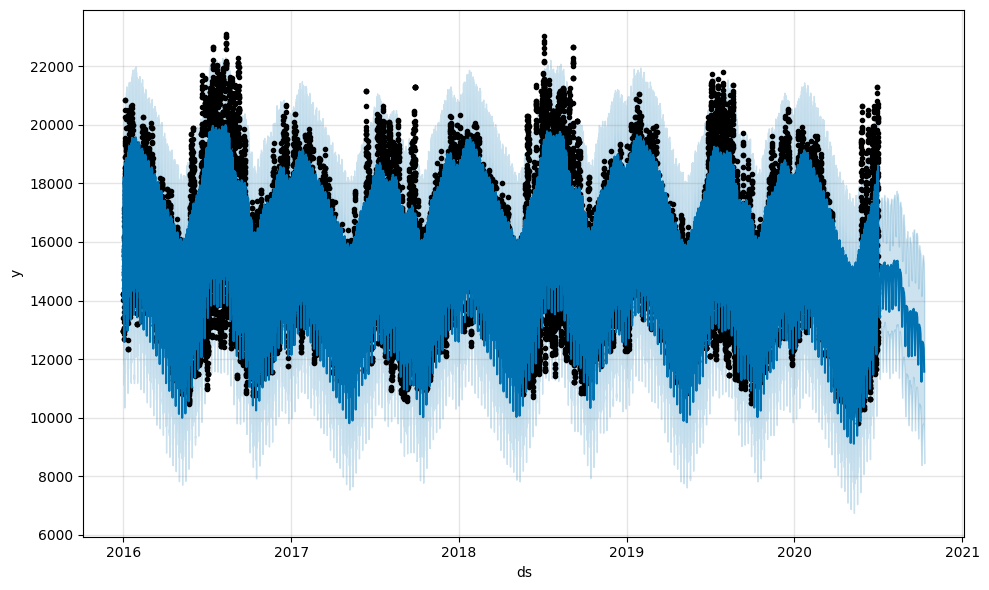

In [ ]:
fig = m.plot(forecast_1)

In [ ]:
from prophet.plot import plot_plotly
import plotly.offline as py

fig = plot_plotly(m, forecast_1)
py.iplot(fig)

NameError: ignored

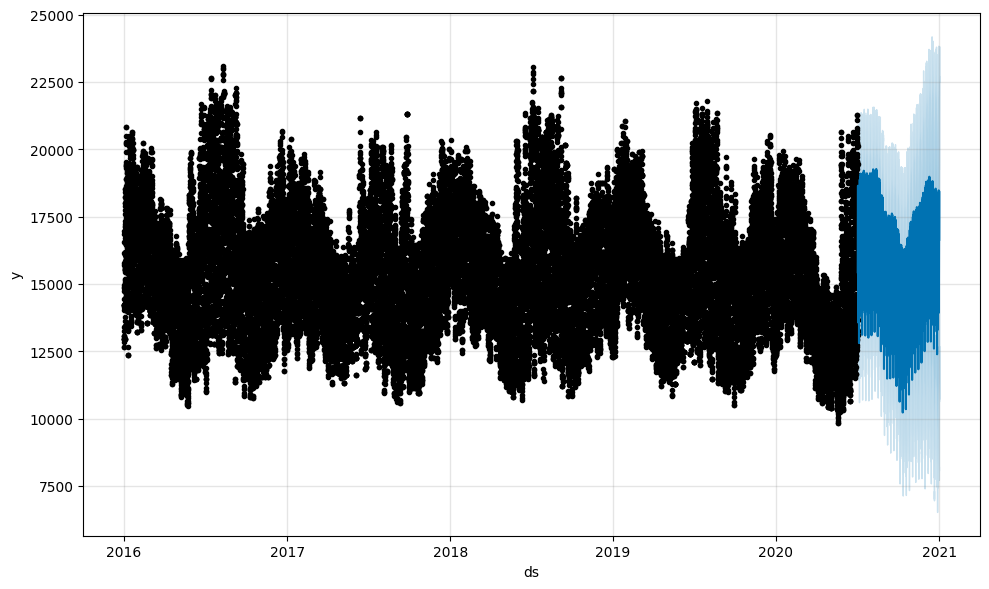

In [ ]:
fig = m.plot(forecast)

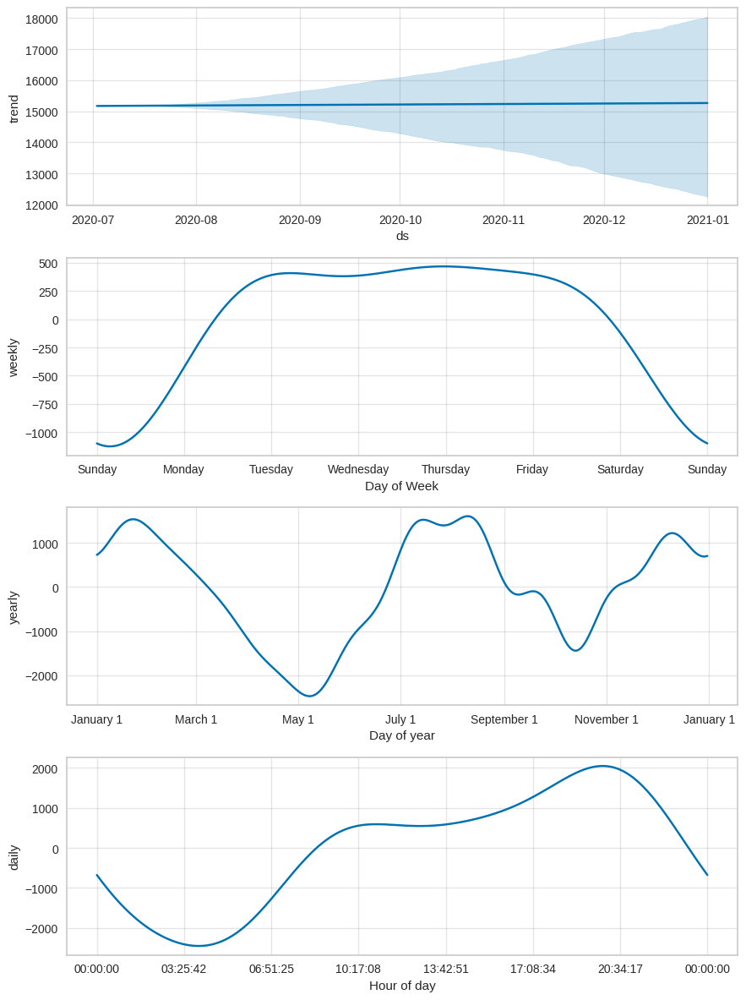

In [ ]:
fig2 = m.plot_components(forecast)

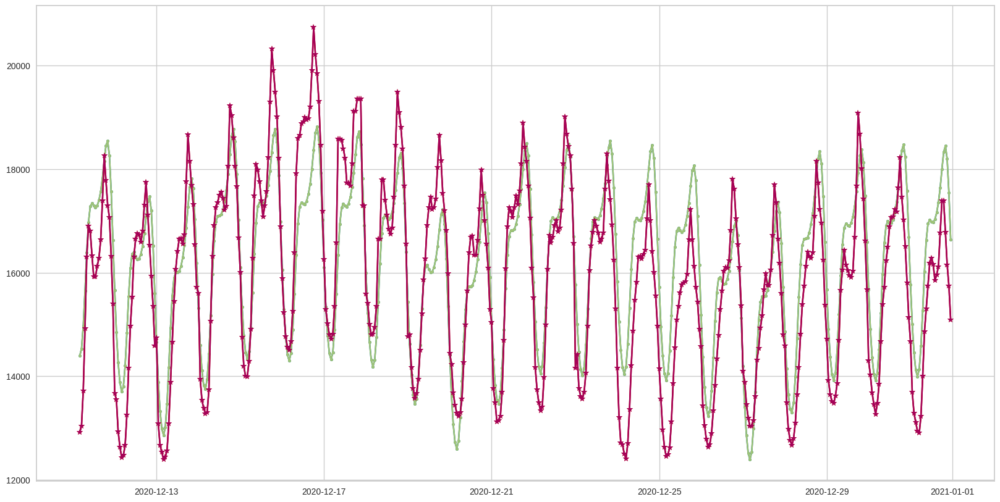

In [ ]:
x = test_demand['ds'].reset_index()
plt.figure(figsize=(20,10))
plt.plot(x.iloc[-500:], forecast['yhat'].iloc[-500:], label='Pred', marker='.')
plt.plot(x.iloc[-500:], test_demand['y'].iloc[-500:], label='True', marker='*')

In [ ]:
mean_absolute_error(y_true=test_demand['y'],
                   y_pred=forecast['yhat'])

1145.3151731694518

In [ ]:
mean_absolute_percentage_error(y_true=test_demand['y'],
                   y_pred=forecast['yhat'])

7.372858931252782